In [0]:
!pip uninstall -y pillow

Skipping pillow as it is not installed.


In [0]:
!pip install pillow-simd --upgrade

Requirement already up-to-date: pillow-simd in /usr/local/lib/python3.6/dist-packages (5.3.0.post1)


In [0]:
!pip install imgaug --upgrade

In [0]:
!pip uninstall -y pillow

Uninstalling Pillow-6.0.0:
  Successfully uninstalled Pillow-6.0.0


In [0]:
!pip install pillow-simd --force --no-cache

    100% |████████████████████████████████| 614kB 76.3MB/s 
  Found existing installation: Pillow-SIMD 5.3.0.post1
    Uninstalling Pillow-SIMD-5.3.0.post1:
      Successfully uninstalled Pillow-SIMD-5.3.0.post1
  Running setup.py install for pillow-simd ... done


In [0]:
!pip install urllib3 --upgrade

  Using cached https://files.pythonhosted.org/packages/df/1c/59cca3abf96f991f2ec3131a4ffe72ae3d9ea1f5894abe8a9c5e3c77cfee/urllib3-1.24.2-py2.py3-none-any.whl
fastai 1.0.51 requires Pillow, which is not installed.
requests 2.18.4 has requirement urllib3<1.23,>=1.21.1, but you'll have urllib3 1.24.2 which is incompatible.
  Found existing installation: urllib3 1.22
    Uninstalling urllib3-1.22:
      Successfully uninstalled urllib3-1.22


In [0]:
!pip uninstall folium -y
!pip uninstall datascience -y 

Uninstalling folium-0.8.3:
  Successfully uninstalled folium-0.8.3
Uninstalling datascience-0.10.6:
  Successfully uninstalled datascience-0.10.6


In [0]:
!pip install requests --upgrade

    100% |████████████████████████████████| 61kB 2.9MB/s 
fastai 1.0.51 requires Pillow, which is not installed.
google-colab 1.0.0 has requirement requests~=2.18.0, but you'll have requests 2.21.0 which is incompatible.
  Found existing installation: requests 2.18.4
    Uninstalling requests-2.18.4:
      Successfully uninstalled requests-2.18.4


In [0]:
!pip install google-colab --upgrade

Requirement already up-to-date: google-colab in /usr/local/lib/python3.6/dist-packages (1.0.0)
    100% |████████████████████████████████| 92kB 4.1MB/s 
    100% |████████████████████████████████| 133kB 9.7MB/s 
fastai 1.0.51 requires Pillow, which is not installed.
  Found existing installation: urllib3 1.24.2
    Uninstalling urllib3-1.24.2:
      Successfully uninstalled urllib3-1.24.2
  Found existing installation: requests 2.21.0
    Uninstalling requests-2.21.0:
      Successfully uninstalled requests-2.21.0


In [0]:
!pip install comet_ml --upgrade

    100% |████████████████████████████████| 102kB 4.6MB/s 
    100% |████████████████████████████████| 204kB 29.9MB/s 
    100% |████████████████████████████████| 389kB 31.6MB/s 
  Stored in directory: /root/.cache/pip/wheels/f1/e4/16/4981ca97c2d65106b49861e0b35e2660695be7219a2d351ee0
Successfully built configobj
comet-git-pure 0.19.11 has requirement urllib3>=1.23, but you'll have urllib3 1.22 which is incompatible.


In [0]:
from comet_ml import Experiment

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
DATA_DIR = "drive/My Drive/Colab Notebooks/data"

In [0]:
import os

In [0]:
os.listdir(DATA_DIR)

['bird', 'non-bird']

In [0]:
experiment = Experiment(project_name="bird-vs-not-bird",api_key="vXmIzDFObhyfUYzH4JUg8rOQp")

COMET INFO: Experiment is live on comet.ml https://www.comet.ml/gaiar/bird-vs-not-bird/c6b77465a0634af6b27e81c7a31b9a8c



In [0]:
import keras
from keras import backend as K
from keras.layers.core import Dense, Activation
from keras.optimizers import Adam
from keras.metrics import categorical_crossentropy
from keras.preprocessing.image import ImageDataGenerator
from keras.preprocessing import image
from keras.models import Model
from keras.applications import imagenet_utils
from keras.layers import Dense,GlobalAveragePooling2D
from keras.applications import MobileNet
from keras.applications.mobilenet import preprocess_input
from keras import callbacks
from keras.callbacks import EarlyStopping
import numpy as np
from IPython.display import Image
from keras.optimizers import Adam

Using TensorFlow backend.


In [0]:
params = {}


params["batch_size"] = 64
params["num_classes"] = 2
params["epochs"]= 20
params["optimizer"] = 'adam' 
params["activation"]= 'relu'
params["validation_split"] = 0.2
params["lr"] = 1e-3
 

In [0]:
def prepare_image(file):
    img_path = ''
    img = image.load_img(img_path + file, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array_expanded_dims = np.expand_dims(img_array, axis=0)
    return keras.applications.mobilenet.preprocess_input(img_array_expanded_dims)

In [0]:
def get_model (params):
    base_model=MobileNet(weights='imagenet',include_top=False) #imports the mobilenet model and discards the last 1000 neuron layer.

    x=base_model.output
    x=GlobalAveragePooling2D()(x)
    x=Dense(1024,activation='relu')(x) #we add dense layers so that the model can learn more complex functions and classify for better results.
    x=Dense(1024,activation='relu')(x) #dense layer 2
    x=Dense(512,activation='relu')(x) #dense layer 3
    preds=Dense(params["num_classes"],activation='softmax')(x) #final layer with softmax activation
    
    model=Model(inputs=base_model.input,outputs=preds)
    
    for layer in model.layers:
      layer.trainable=False

    # or if we want to set the first 20 layers of the network to be non-trainable
    for layer in model.layers[:20]:
      layer.trainable=False
    for layer in model.layers[20:]:
      layer.trainable=True
    
    return model

In [0]:
model = get_model(params)

Instructions for updating:
Colocations handled automatically by placer.


/usr/local/lib/python3.6/dist-packages/keras_applications/mobilenet.py:208: UserWarning: MobileNet shape is undefined. Weights for input shape (224, 224) will be loaded.
  warnings.warn('MobileNet shape is undefined.'


In [0]:
model.summary()

In [0]:
train_datagen = ImageDataGenerator(preprocessing_function=preprocess_input,
                                   rescale=1./255,
                                   shear_range=0.2,
                                   zoom_range=0.2,
                                   horizontal_flip=True,
                                   validation_split=params["validation_split"])  # included in our dependencies


In [0]:
train_generator=train_datagen.flow_from_directory(DATA_DIR,
                                                 target_size=(224,224),
                                                 color_mode='rgb',
                                                 batch_size=params["batch_size"],
                                                 class_mode='categorical',
                                                 shuffle=True,
                                                 )

Found 1906 images belonging to 2 classes.


In [0]:
validation_generator = train_datagen.flow_from_directory(DATA_DIR,
                                                 target_size=(224,224),
                                                 color_mode='rgb',
                                                 batch_size=params["batch_size"],
                                                 class_mode='categorical',
                                                 shuffle=True,
                                                 subset='validation')

Found 380 images belonging to 2 classes.


In [0]:
model.compile(optimizer=params["optimizer"],loss='categorical_crossentropy',metrics=['accuracy'])

In [0]:
import warnings

In [0]:
warnings.filterwarnings("ignore", "(Possibly )?corrupt EXIF data", UserWarning)

In [0]:
#experiment.display()

In [0]:
# log parameters in Comet.ml
experiment.log_parameters(params)

## Setup callbacks 

In [0]:
log = callbacks.CSVLogger("drive/My Drive/Colab Notebooks/birds" + '/bird-vs-not-bird-log.csv')

checkpoint = callbacks.ModelCheckpoint("drive/My Drive/Colab Notebooks/birds" + '/bird-vs-not-bird-weights-{epoch:02d}.h5',
                                           save_best_only=True, 
                                           save_weights_only=True,
                                           verbose=1)

lr_decay = callbacks.LearningRateScheduler(schedule=lambda epoch: params["lr"] * (0.9 ** epoch))

early_stopping = EarlyStopping(monitor='val_loss', min_delta=1e-4, patience=5, verbose=1, mode='auto')

## Train the model

In [0]:
with experiment.train():
    step_size_train = train_generator.n//params["batch_size"]
    history = model.fit_generator(generator=train_generator,
                                  validation_data=validation_generator,
                                  validation_steps=validation_generator.samples//params["batch_size"],
                                  steps_per_epoch=step_size_train,
                                  epochs=params["epochs"],
                                  verbose=1,
                                  callbacks=[log,checkpoint,lr_decay],
                                  use_multiprocessing=True,
                                                          )

Epoch 1/20
29/29 [==============================] - 57s 2s/step - loss: 0.0472 - acc: 0.9898 - val_loss: 3.9739 - val_acc: 0.6156

Epoch 00001: val_loss did not improve from 2.67879
Epoch 2/20
29/29 [==============================] - 52s 2s/step - loss: 0.0887 - acc: 0.9704 - val_loss: 6.2490 - val_acc: 0.5538

Epoch 00002: val_loss did not improve from 2.67879
Epoch 3/20
29/29 [==============================] - 51s 2s/step - loss: 0.0552 - acc: 0.9803 - val_loss: 2.8513 - val_acc: 0.6456

Epoch 00003: val_loss did not improve from 2.67879
Epoch 4/20
29/29 [==============================] - 53s 2s/step - loss: 0.0414 - acc: 0.9865 - val_loss: 3.7888 - val_acc: 0.5601

Epoch 00004: val_loss did not improve from 2.67879
Epoch 5/20
29/29 [==============================] - 52s 2s/step - loss: 0.0264 - acc: 0.9919 - val_loss: 4.5933 - val_acc: 0.6297

Epoch 00005: val_loss did not improve from 2.67879
Epoch 6/20
29/29 [==============================] - 51s 2s/step - loss: 0.0228 - acc: 0.99

In [0]:
model.save_weights("drive/My Drive/Colab Notebooks/birds/mobilenet.bird-vs-not-bird.overfit.h5")

In [0]:
experiment.end()

COMET INFO: ----------------------------
COMET INFO: Comet.ml Experiment Summary:
COMET INFO:   Data:
COMET INFO:     url: https://www.comet.ml/gaiar/bird-vs-not-bird/c6b77465a0634af6b27e81c7a31b9a8c
COMET INFO:   Metrics:
COMET INFO:               sys.gpu.0.free_memory: 6650003456
COMET INFO:           sys.gpu.0.gpu_utilization: 0
COMET INFO:              sys.gpu.0.total_memory: 15812263936
COMET INFO:               sys.gpu.0.used_memory: 9162260480
COMET INFO:                           train_acc: 0.999457111834962
COMET INFO:                     train_batch_acc: 1.0
COMET INFO:                    train_batch_loss: 0.00018079681
COMET INFO:                     train_epoch_end: 19
COMET INFO:                          train_loss: 0.0006486274335268981
COMET INFO:                            train_lr: 0.00013508517
COMET INFO:                          train_step: 580
COMET INFO:         train_sys.gpu.0.free_memory: 6650003456
COMET INFO:     train_sys.gpu.0.gpu_utilization: 10
COMET INFO:

# Testing predictions

In [0]:
%matplotlib inline

import matplotlib
import numpy as np
import matplotlib.pyplot as plt


from keras.models import load_model
import scipy



Connecting Google Drive with saved model

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
model = get_model(params)

/usr/local/lib/python3.6/dist-packages/keras_applications/mobilenet.py:208: UserWarning: MobileNet shape is undefined. Weights for input shape (224, 224) will be loaded.
  warnings.warn('MobileNet shape is undefined.'


In [0]:
model.load_weights("drive/My Drive/Colab Notebooks/birds/mobilenet.bird-vs-not-bird.overfit.h5")

In [0]:
def load_image(img_path, show=False):
    img = image.load_img(img_path, target_size=(150, 150))
    img_tensor = image.img_to_array(img)                    # (height, width, channels)
    img_tensor = np.expand_dims(img_tensor, axis=0)         # (1, height, width, channels), add a dimension because the model expects this shape: (batch_size, height, width, channels)
    img_tensor /= 255.                                      # imshow expects values in the range [0, 1]
    if show:
        plt.imshow(img_tensor[0])                           
        plt.axis('off')
        plt.show()
    #return img_tensor

  




In [0]:
img_path = 'drive/My Drive/Colab Notebooks/birds/test/Schwanzmeise/schwanzmeise_1204610_57923342.jpg'
new_image = prepare_image(img_path)

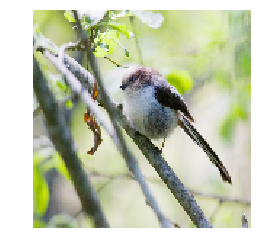

array([[[[0.84313726, 0.8901961 , 0.60784316],
         [0.83137256, 0.8784314 , 0.5803922 ],
         [0.8235294 , 0.8784314 , 0.5372549 ],
         ...,
         [0.73333335, 0.8039216 , 0.6       ],
         [0.7294118 , 0.8117647 , 0.5882353 ],
         [0.7411765 , 0.81960785, 0.57254905]],

        [[0.84705883, 0.8901961 , 0.6313726 ],
         [0.827451  , 0.8784314 , 0.5686275 ],
         [0.8235294 , 0.8784314 , 0.5372549 ],
         ...,
         [0.7176471 , 0.79607844, 0.5647059 ],
         [0.7137255 , 0.7921569 , 0.5529412 ],
         [0.7372549 , 0.8235294 , 0.5803922 ]],

        [[0.8352941 , 0.8784314 , 0.6117647 ],
         [0.8235294 , 0.8745098 , 0.56078434],
         [0.8235294 , 0.8784314 , 0.54509807],
         ...,
         [0.7176471 , 0.7882353 , 0.54509807],
         [0.7176471 , 0.7764706 , 0.52156866],
         [0.72156864, 0.8       , 0.5686275 ]],

        ...,

        [[0.67058825, 0.7764706 , 0.23137255],
         [0.62352943, 0.75686276, 0.14509805]

In [0]:
load_image(img_path, True)

In [0]:
y_prob = model.predict(new_image)
y_classes = y_prob.argmax(axis=-1)
y_classes

array([0])

In [0]:
labels = validation_generator.class_indices.keys()
labels

dict_keys(['bird', 'non-bird'])

In [0]:
import os

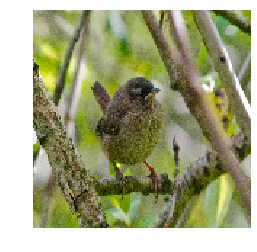

non-bird
zaunkönig_35.jpg


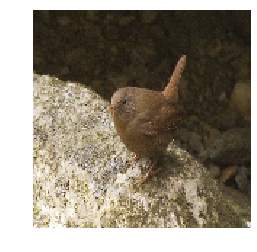

non-bird
zaunkönig_92.jpg


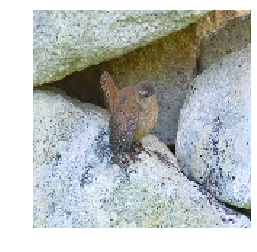

non-bird
zaunkönig_19.jpg


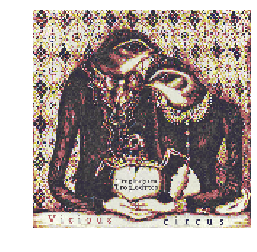

non-bird
zaunkönig_41.jpg


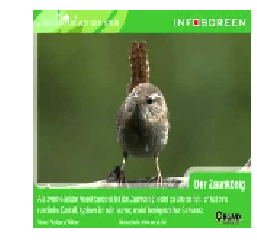

non-bird
zaunkönig_42.jpg


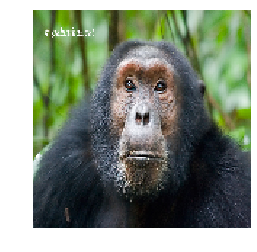

non-bird
zaunkönig_72.jpg


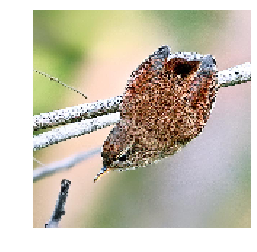

non-bird
zaunkönig_63.jpg


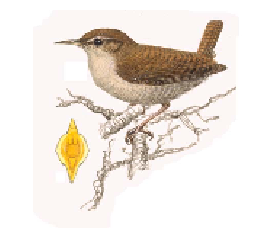

non-bird
zaunkönig_48.jpg


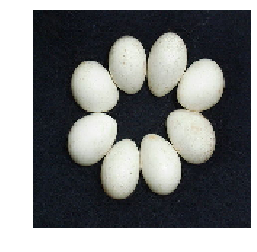

non-bird
zaunkönig_87.jpg


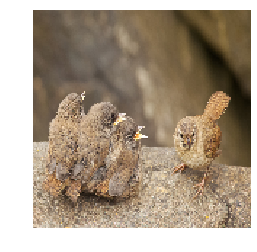

non-bird
zaunkönig_13.jpg


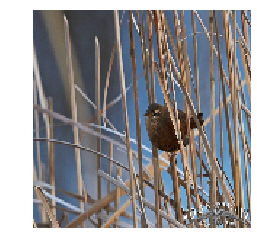

non-bird
zaunkönig_73.jpg


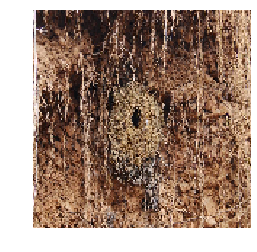

non-bird
zaunkönig_74.jpg


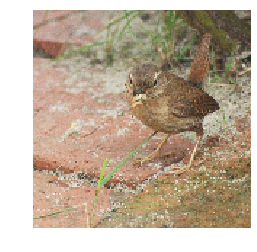

non-bird
zaunkönig_20.jpg


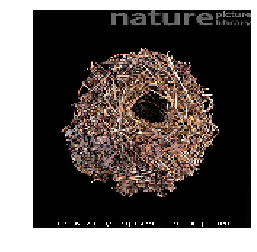

non-bird
zaunkönig_93.jpg


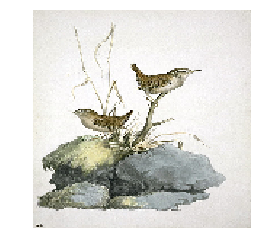

non-bird
zaunkönig_27.jpg


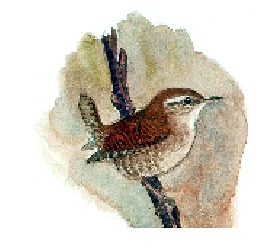

non-bird
zaunkönig_17.jpg


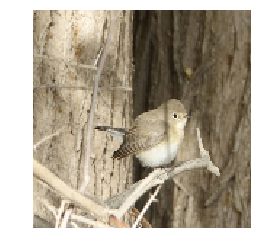

non-bird
zwergschnäpper_77.jpg


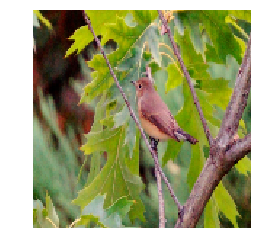

non-bird
zwergschnäpper_79.jpg


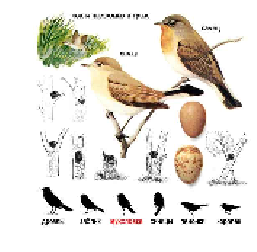

non-bird
zwergschnäpper_13.jpg


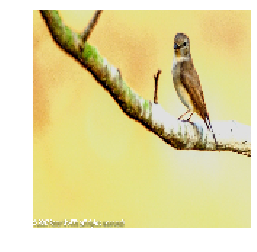

non-bird
zwergschnäpper_47.jpg


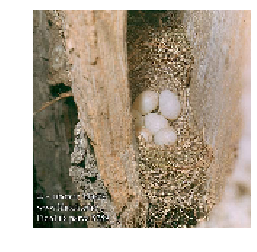

non-bird
zwergschnäpper_54.jpg


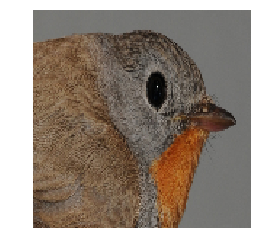

non-bird
zwergschnäpper_55.jpg


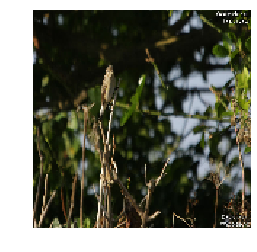

non-bird
zwergschnäpper_52.jpg


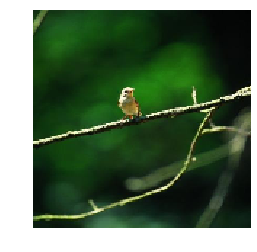

non-bird
zwergschnäpper_5.jpg


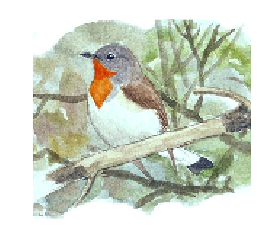

non-bird
zwergschnäpper_25.jpg


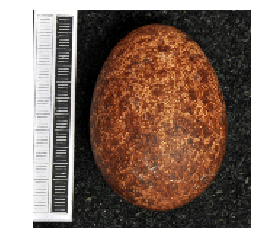

non-bird
wanderfalke_38.jpg


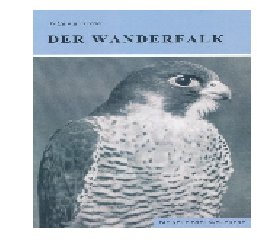

non-bird
wanderfalke_87.jpg


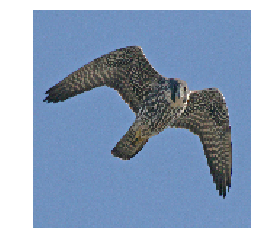

non-bird
wanderfalke_72.jpg


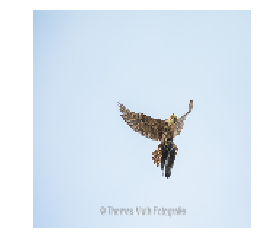

non-bird
wanderfalke_57.jpg


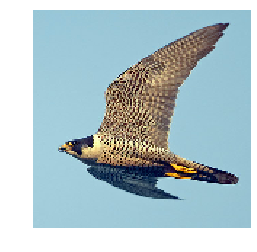

non-bird
wanderfalke_76.jpg


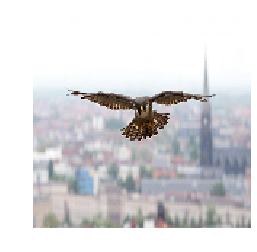

non-bird
wanderfalke_24.jpg


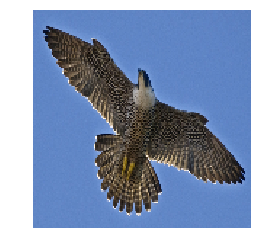

non-bird
wanderfalke_26.jpg


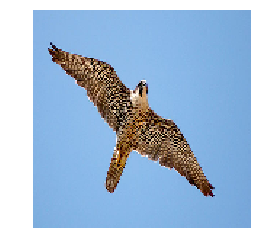

non-bird
wanderfalke_75.jpg


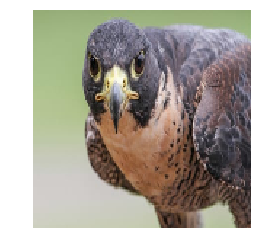

non-bird
wanderfalke_48.jpg


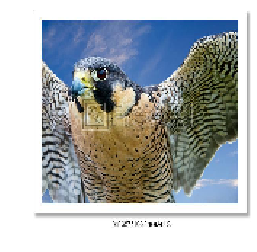

non-bird
wanderfalke_74.jpg


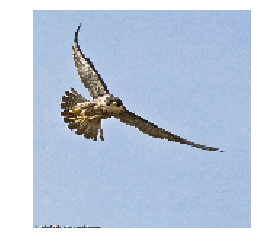

non-bird
wanderfalke_89.jpg


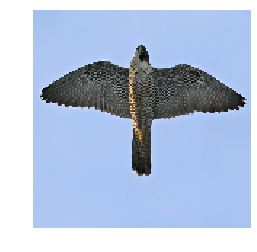

non-bird
wanderfalke_22.jpg


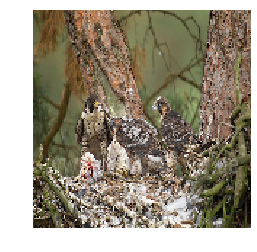

non-bird
wanderfalke_36.jpg


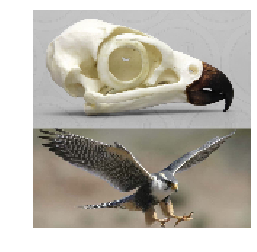

non-bird
wanderfalke_73.jpg


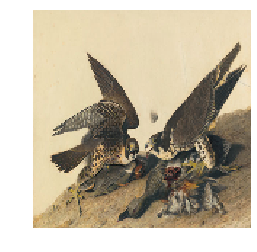

non-bird
wanderfalke_27.jpg


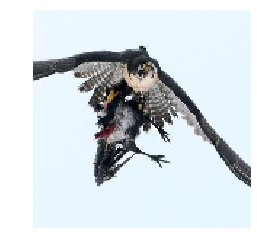

non-bird
wanderfalke_2.jpg


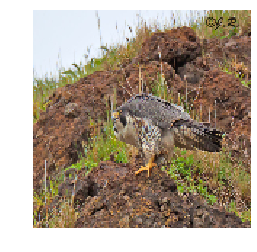

non-bird
wanderfalke_84.jpg


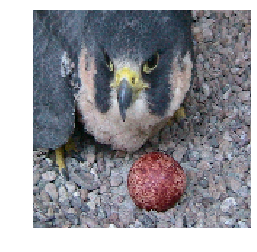

non-bird
wanderfalke_3.jpg


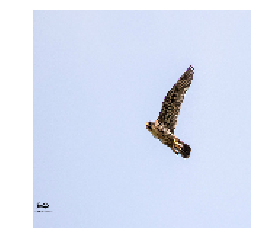

non-bird
wanderfalke_60.jpg


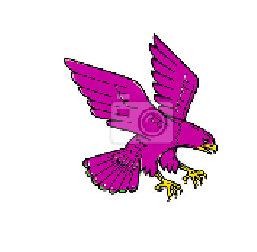

non-bird
wanderfalke_63.jpg


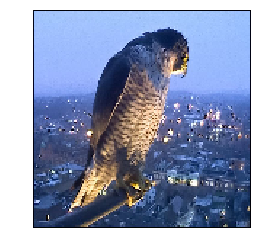

non-bird
wanderfalke_85.jpg


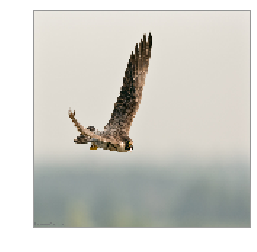

non-bird
wanderfalke_62.jpg


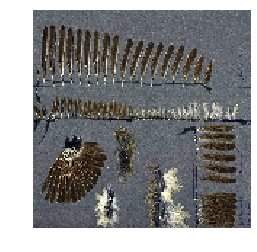

non-bird
sumpfrohrsänger_39.jpg


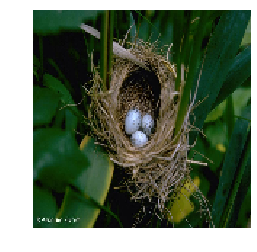

non-bird
sumpfrohrsänger_22.jpg


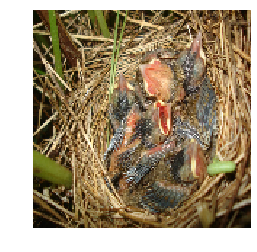

non-bird
sumpfrohrsänger_89.jpg


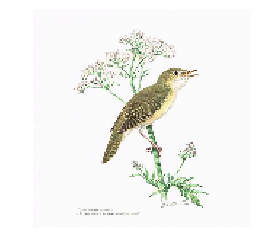

non-bird
sumpfrohrsänger_70.jpg


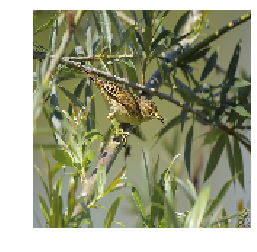

non-bird
sumpfrohrsänger_43.jpg


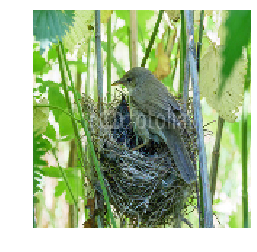

non-bird
sumpfrohrsänger_62.jpg


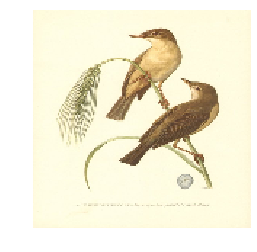

non-bird
sumpfrohrsänger_85.jpg


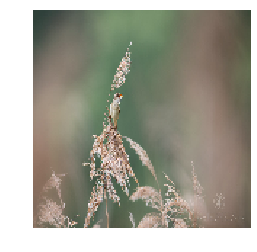

non-bird
sumpfrohrsänger_49.jpg


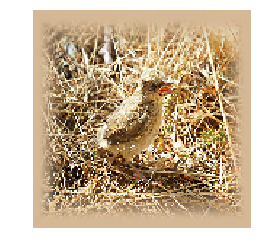

non-bird
sumpfrohrsänger_35.jpg


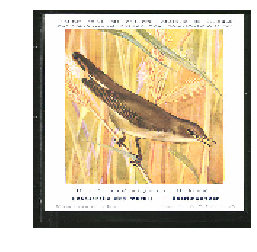

non-bird
sumpfrohrsänger_12.jpg


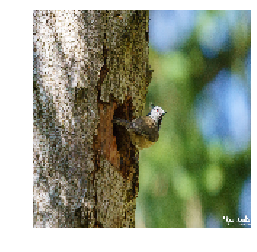

non-bird
haubenmeise_62.jpg


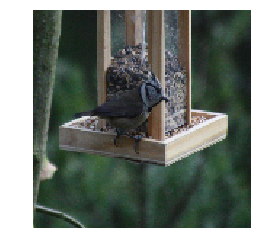

non-bird
haubenmeise_93.jpg


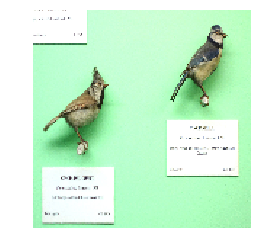

non-bird
haubenmeise_2.jpg


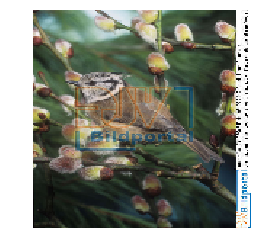

non-bird
haubenmeise_65.jpg


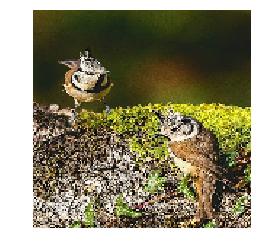

non-bird
haubenmeise_74.jpg


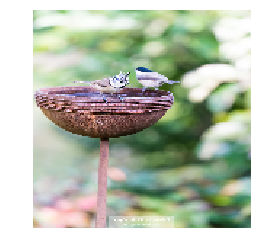

non-bird
haubenmeise_25.jpg


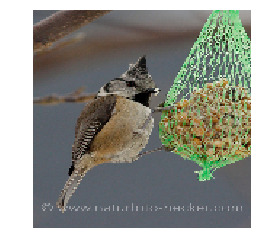

non-bird
haubenmeise_41.jpg


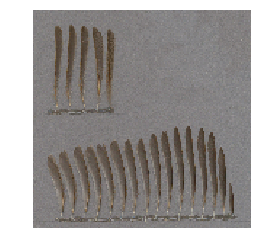

non-bird
haubenmeise_1.jpg


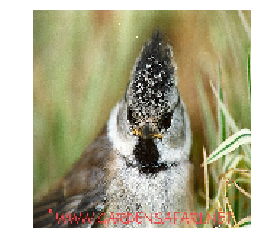

non-bird
haubenmeise_79.jpg


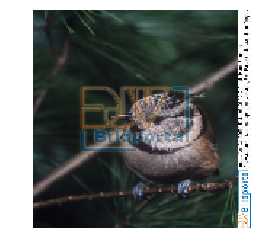

non-bird
haubenmeise_58.jpg


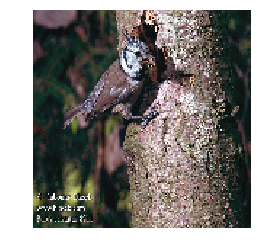

non-bird
haubenmeise_90.jpg


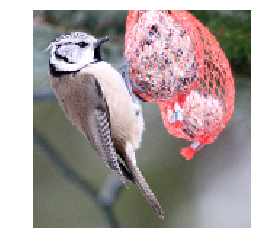

non-bird
haubenmeise_22.jpg


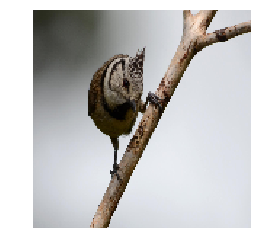

non-bird
haubenmeise_40.jpg


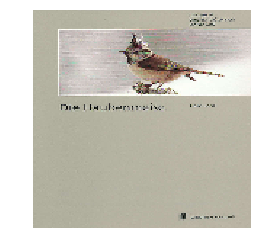

non-bird
haubenmeise_73.jpg


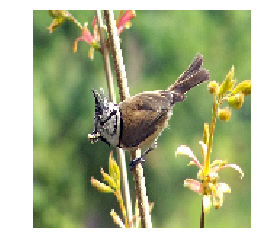

non-bird
haubenmeise_21.jpg


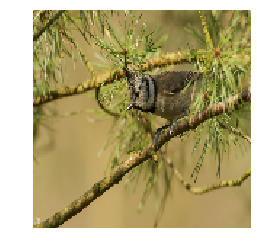

non-bird
haubenmeise_24.jpg


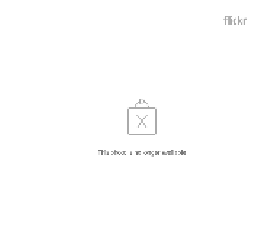

non-bird
haubenmeise_69.png


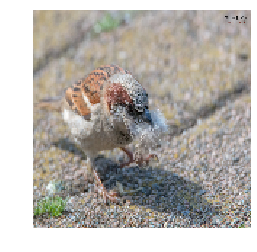

non-bird
haussperling spatz_30.jpg


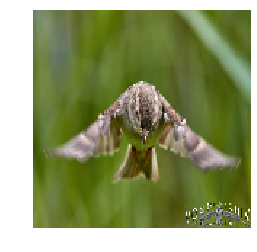

non-bird
haussperling spatz_89.jpg


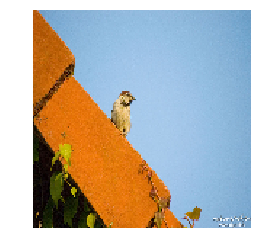

non-bird
haussperling spatz_25.jpg


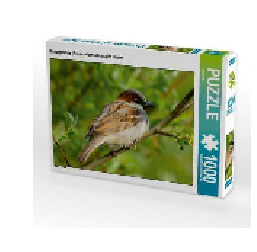

non-bird
haussperling spatz_12.jpg


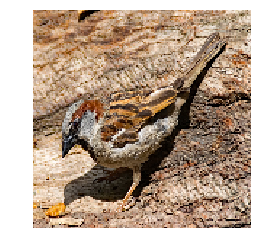

non-bird
haussperling spatz_85.jpg


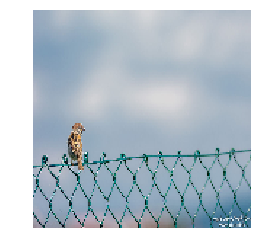

non-bird
haussperling spatz_44.jpg


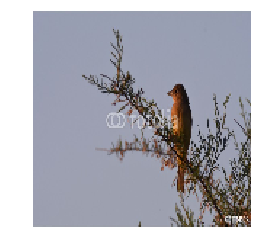

non-bird
haussperling spatz_53.jpg


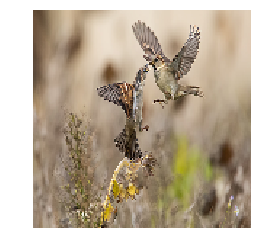

non-bird
haussperling spatz_73.jpg


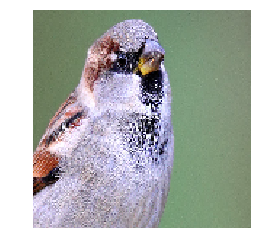

non-bird
haussperling spatz_57.jpg


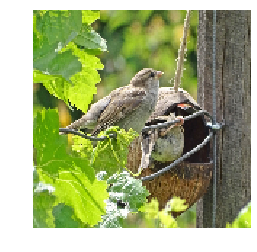

non-bird
haussperling spatz_24.jpg


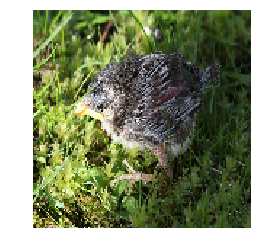

non-bird
haussperling spatz_51.jpg


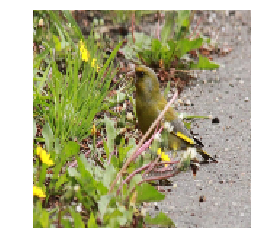

non-bird
grünfink grünling_59.jpg


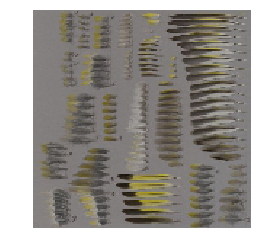

non-bird
grünfink grünling_8.jpg


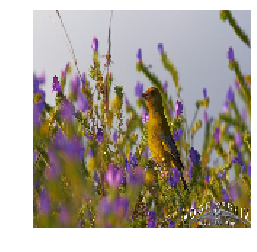

non-bird
grünfink grünling_62.jpg


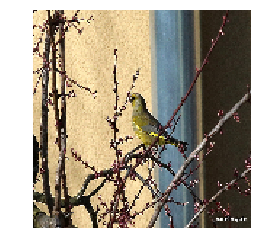

non-bird
grünfink grünling_11.jpg


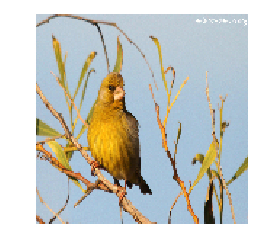

non-bird
grünfink grünling_23.jpg


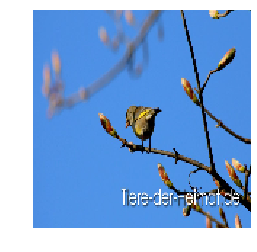

non-bird
grünfink grünling_61.jpg


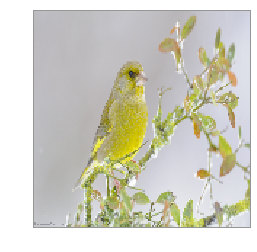

non-bird
grünfink grünling_79.jpg


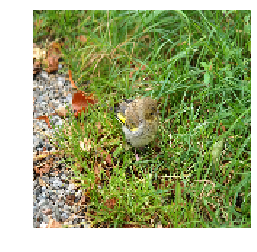

non-bird
grünfink grünling_74.jpg


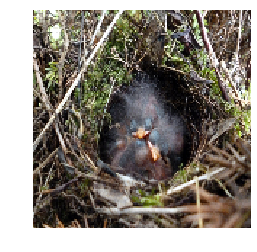

non-bird
heckenbraunelle_57.jpg


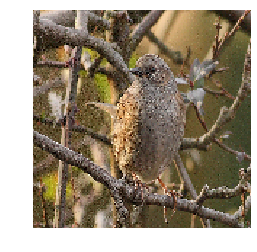

non-bird
heckenbraunelle_66.jpg


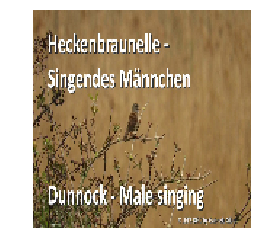

non-bird
heckenbraunelle_64.jpg


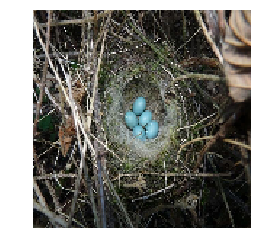

non-bird
heckenbraunelle_34.jpg


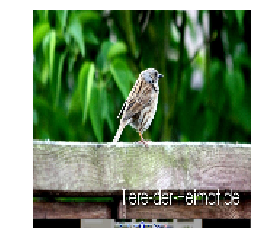

non-bird
heckenbraunelle_67.jpg


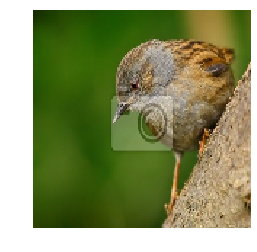

non-bird
heckenbraunelle_43.jpg


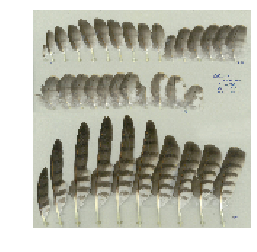

non-bird
sperber_34.jpg


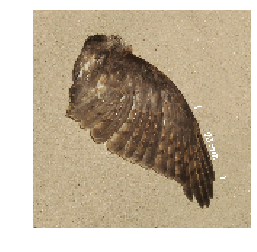

non-bird
sperber_35.jpg


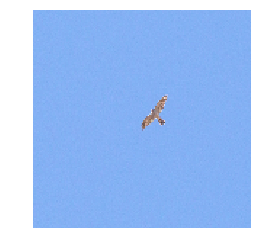

non-bird
sperber_19.jpg


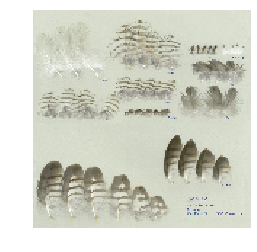

non-bird
sperber_56.jpg


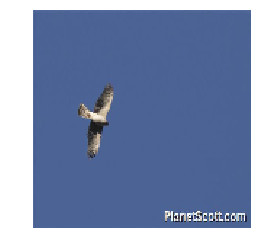

non-bird
sperber_33.jpg


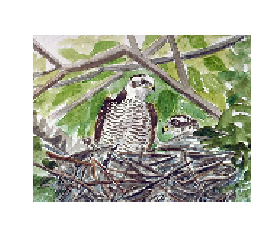

non-bird
sperber_91.jpg


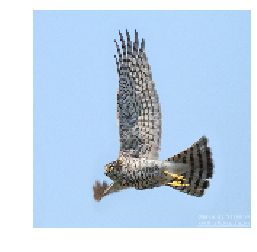

non-bird
sperber_62.jpg


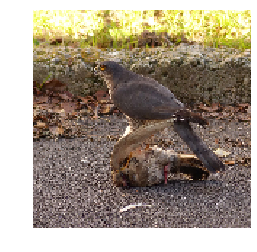

non-bird
sperber_73.jpg


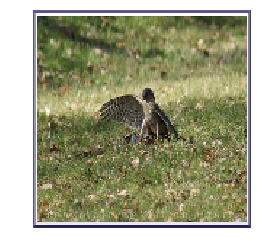

non-bird
sperber_89.jpg


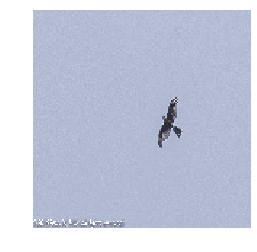

non-bird
sperber_87.jpg


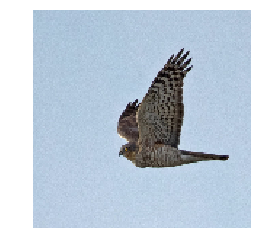

non-bird
sperber_36.jpg


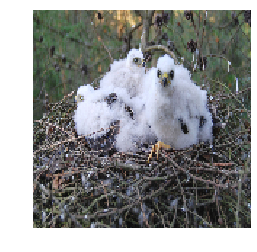

non-bird
sperber_57.jpg


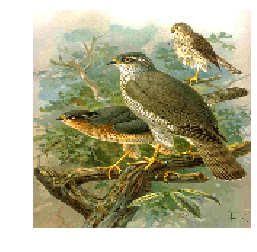

non-bird
sperber_51.jpg


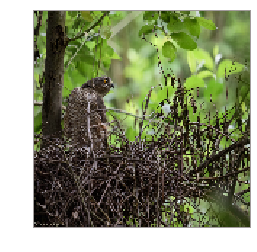

non-bird
sperber_85.jpg


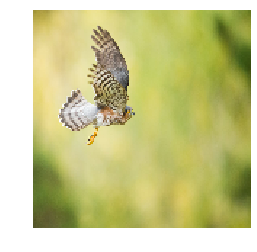

non-bird
sperber_5.jpg


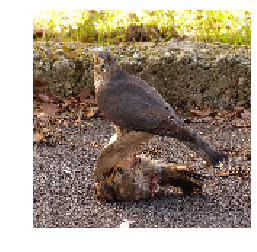

non-bird
sperber_39.jpg


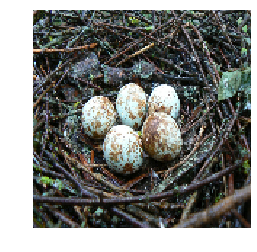

non-bird
sperber_82.jpg


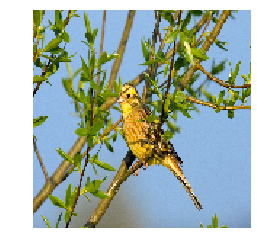

non-bird
goldammer_44.jpg


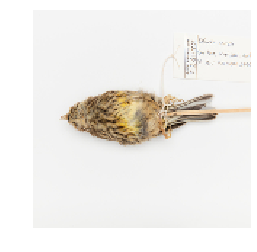

non-bird
goldammer_11.jpg


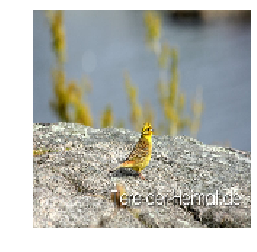

non-bird
goldammer_31.jpg


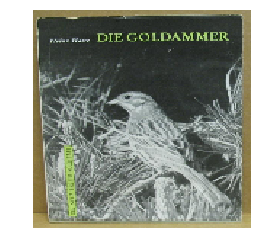

non-bird
goldammer_61.jpg


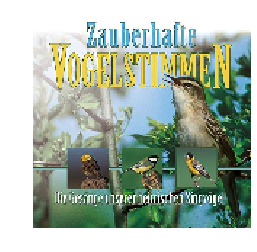

non-bird
goldammer_34.jpg


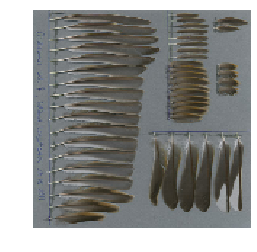

non-bird
goldammer_43.jpg


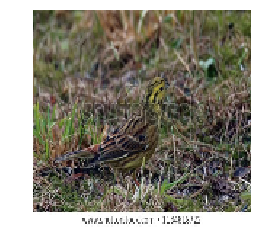

non-bird
goldammer_12.jpg


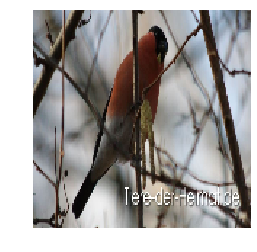

non-bird
gimpel dompfaff_55.jpg


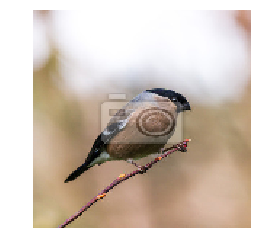

non-bird
gimpel dompfaff_12.jpg


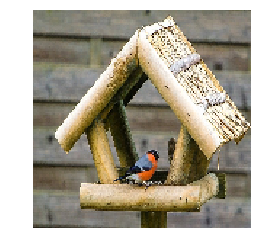

non-bird
gimpel dompfaff_64.jpg


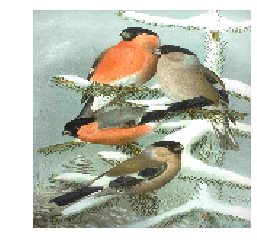

non-bird
gimpel dompfaff_17.jpg


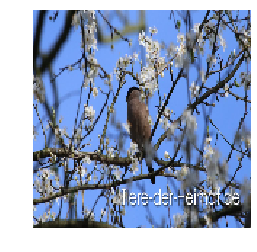

non-bird
gimpel dompfaff_58.jpg


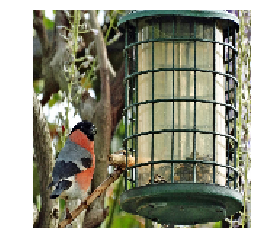

non-bird
gimpel dompfaff_4.jpg


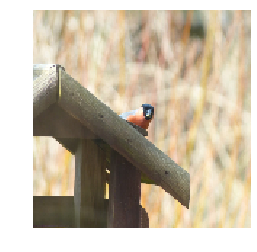

non-bird
gimpel dompfaff_36.jpg


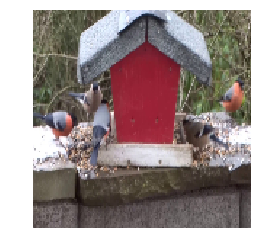

non-bird
gimpel dompfaff_41.jpg


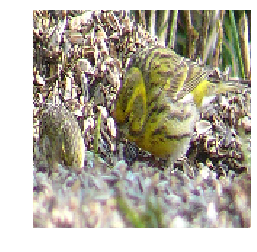

non-bird
girlitz_52.jpg


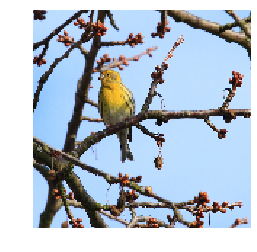

non-bird
girlitz_47.jpg


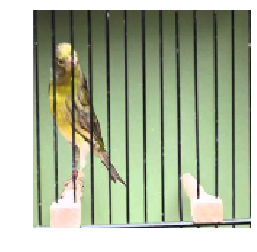

non-bird
girlitz_1.jpg


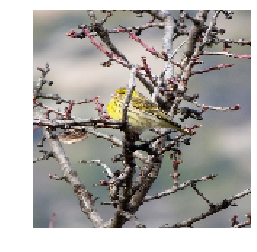

non-bird
girlitz_14.jpg


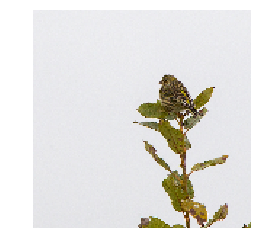

non-bird
girlitz_76.jpg


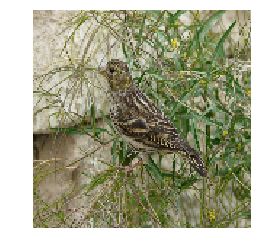

non-bird
girlitz_62.jpg


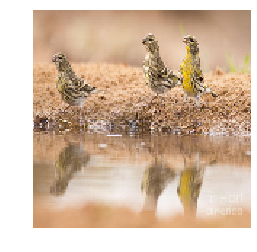

non-bird
girlitz_21.jpg


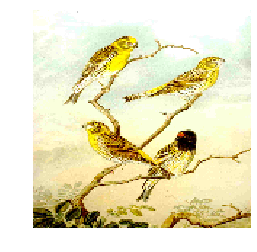

non-bird
girlitz_13.jpg


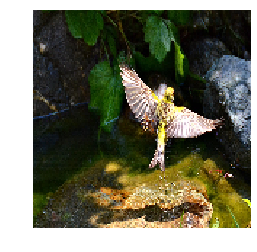

non-bird
girlitz_57.jpg


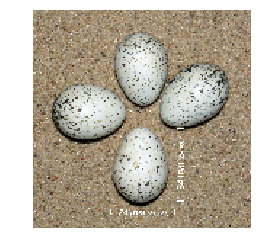

non-bird
dohle_28.jpg


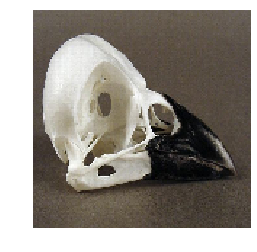

non-bird
dohle_49.jpg


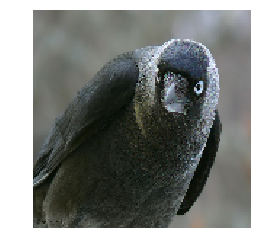

non-bird
dohle_40.jpg


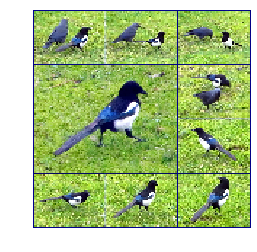

non-bird
dohle_51.jpg


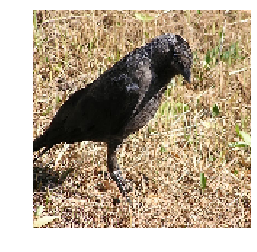

non-bird
dohle_83.jpg


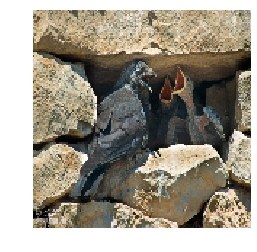

non-bird
dohle_79.jpg


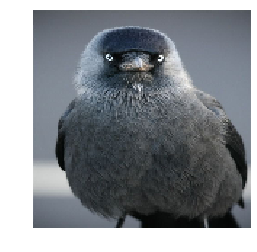

non-bird
dohle_34.jpg


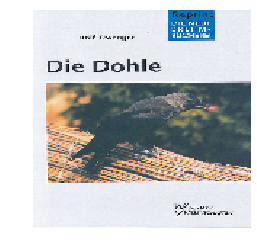

non-bird
dohle_76.jpg


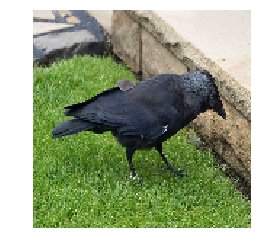

non-bird
dohle_64.jpg


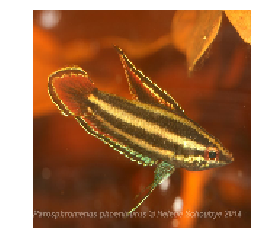

non-bird
gartenrotschwanz_26.jpg


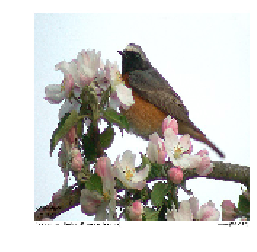

non-bird
gartenrotschwanz_53.jpg


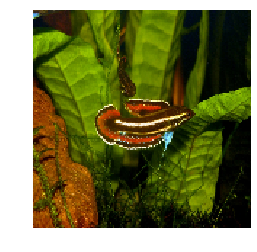

non-bird
gartenrotschwanz_40.jpg


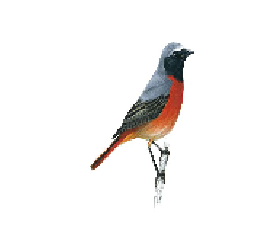

non-bird
gartenrotschwanz_41.jpg


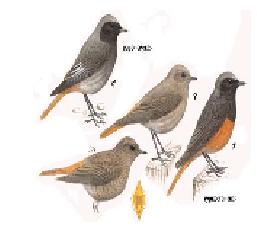

non-bird
gartenrotschwanz_74.jpg


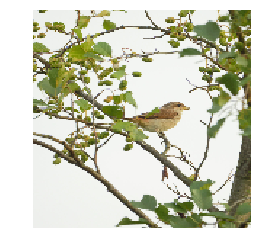

non-bird
neuntöter_85.jpg


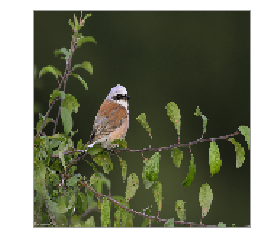

non-bird
neuntöter_10.jpg


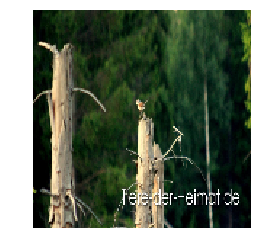

non-bird
neuntöter_28.jpg


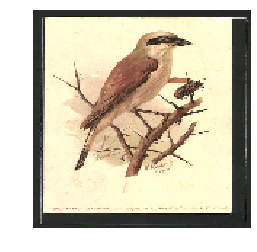

non-bird
neuntöter_47.jpg


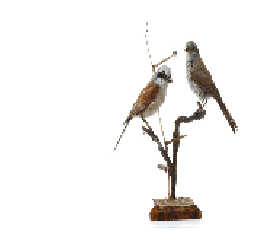

non-bird
neuntöter_24.jpg


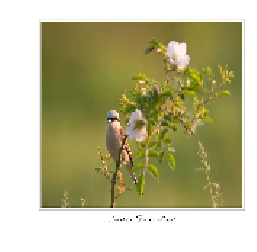

non-bird
neuntöter_70.jpg


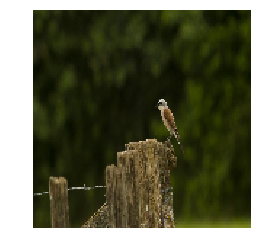

non-bird
neuntöter_2.jpg


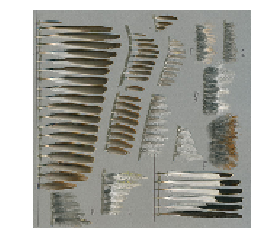

non-bird
neuntöter_69.jpg


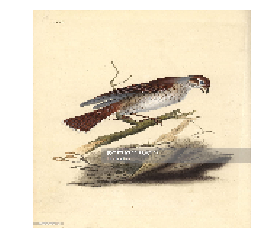

non-bird
neuntöter_58.jpg


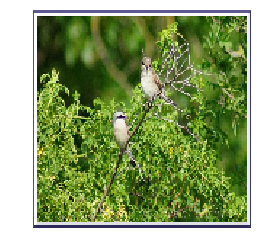

non-bird
neuntöter_73.jpg


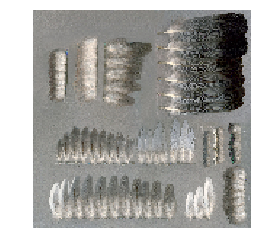

non-bird
ringeltaube_5.jpg


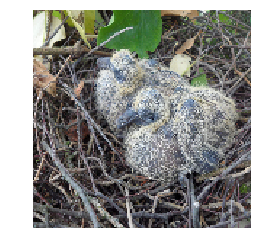

non-bird
ringeltaube_52.jpg


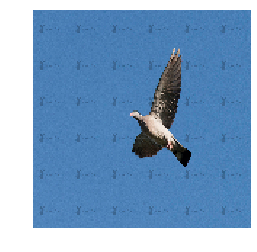

non-bird
ringeltaube_51.jpg


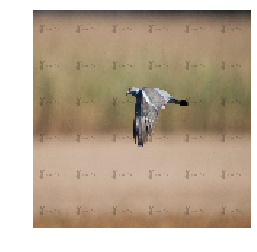

non-bird
ringeltaube_0.jpg


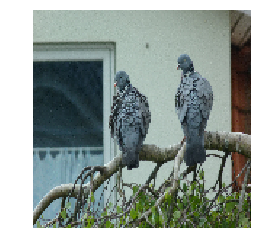

non-bird
ringeltaube_36.jpg


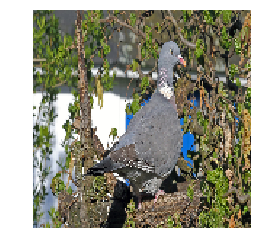

non-bird
ringeltaube_30.jpg


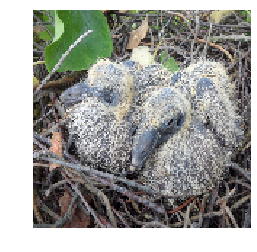

non-bird
ringeltaube_55.jpg


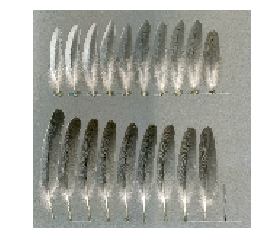

non-bird
ringeltaube_12.jpg


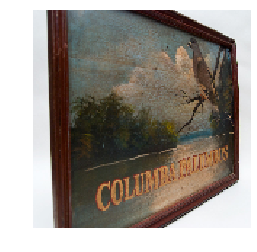

non-bird
ringeltaube_82.jpg


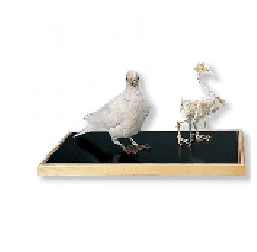

non-bird
ringeltaube_15.jpg


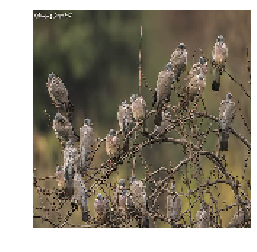

non-bird
ringeltaube_41.jpg


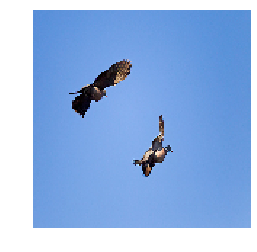

non-bird
ringeltaube_27.jpg


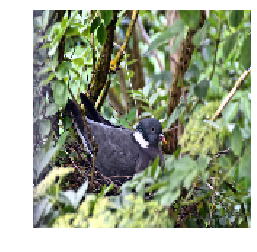

non-bird
ringeltaube_17.jpg


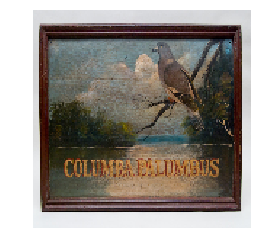

non-bird
ringeltaube_40.jpg


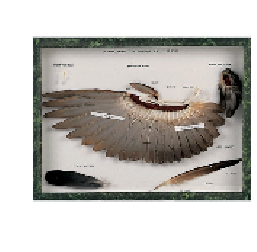

non-bird
ringeltaube_70.jpg


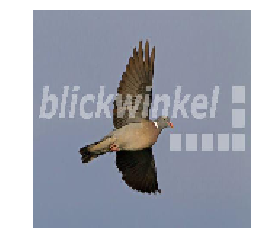

non-bird
ringeltaube_42.jpg


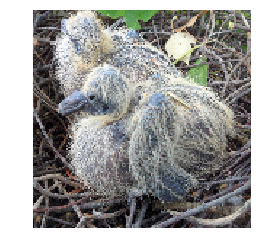

non-bird
ringeltaube_85.jpg


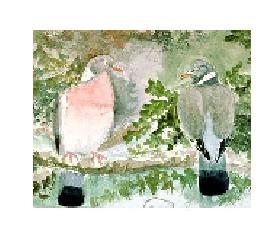

non-bird
ringeltaube_4.jpg


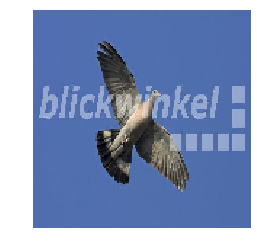

non-bird
ringeltaube_48.jpg


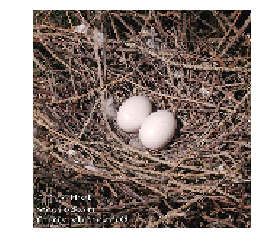

non-bird
ringeltaube_61.jpg


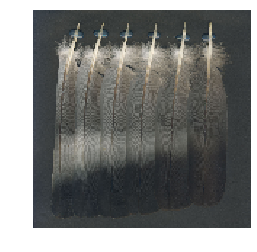

non-bird
ringeltaube_88.jpg


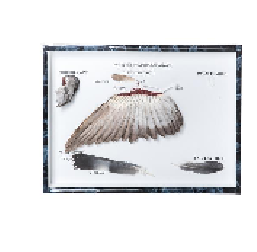

non-bird
ringeltaube_67.jpg


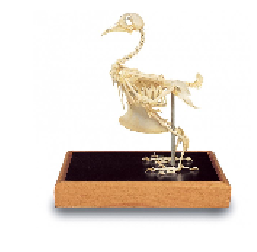

non-bird
ringeltaube_39.jpg


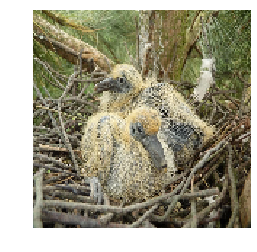

non-bird
ringeltaube_25.jpg


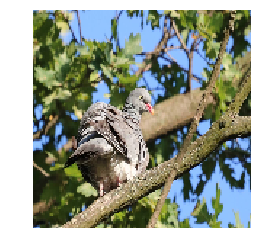

non-bird
ringeltaube_92.jpg


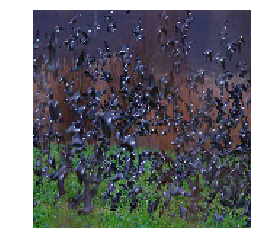

non-bird
ringeltaube_11.jpg


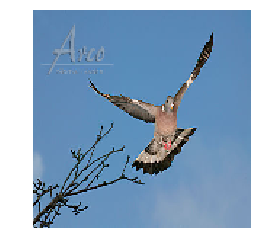

non-bird
ringeltaube_71.jpg


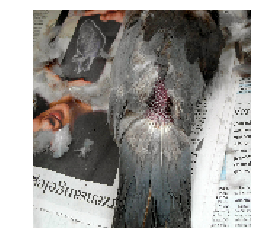

non-bird
ringeltaube_2.jpg


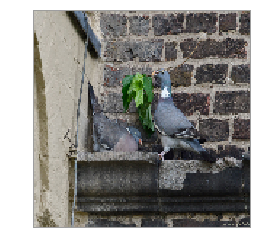

non-bird
ringeltaube_56.jpg


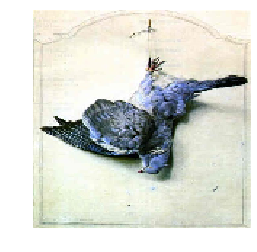

non-bird
ringeltaube_46.jpg


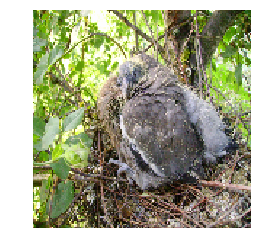

non-bird
ringeltaube_23.jpg


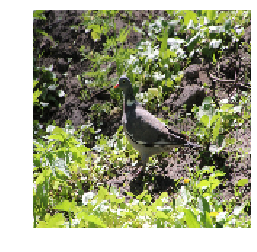

non-bird
ringeltaube_44.jpg


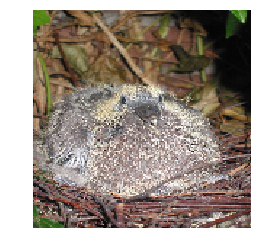

non-bird
ringeltaube_81.jpg


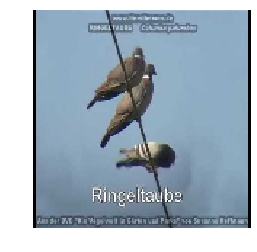

non-bird
ringeltaube_35.jpg


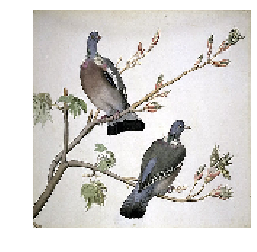

non-bird
ringeltaube_74.jpg


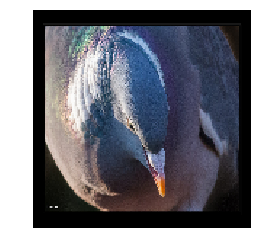

non-bird
ringeltaube_29.jpg


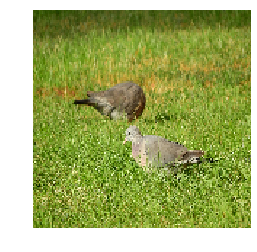

non-bird
ringeltaube_45.jpg


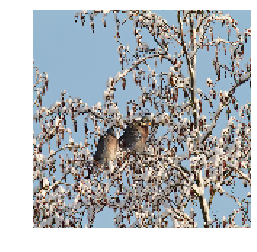

non-bird
ringeltaube_16.jpg


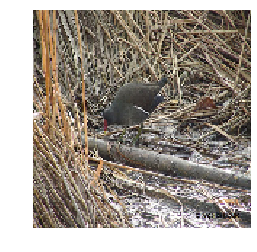

non-bird
teichhuhn_0.jpg


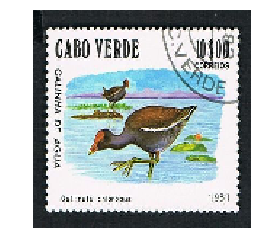

non-bird
teichhuhn_24.jpg


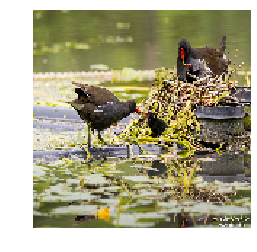

non-bird
teichhuhn_18.jpg


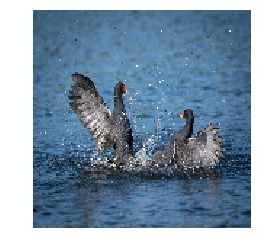

non-bird
teichhuhn_22.jpg


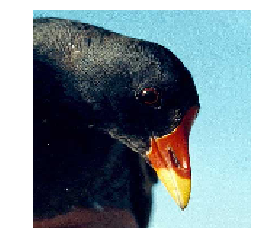

non-bird
teichhuhn_85.jpg


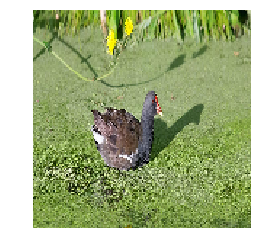

non-bird
teichhuhn_12.jpg


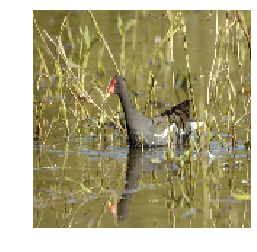

non-bird
teichhuhn_55.jpg


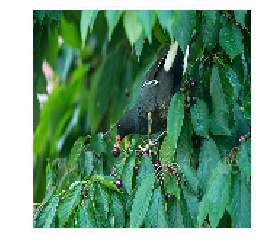

non-bird
teichhuhn_35.jpg


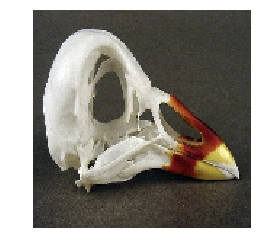

non-bird
teichhuhn_11.jpg


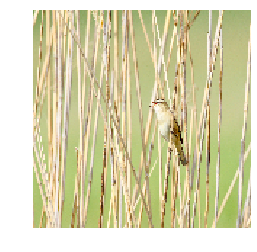

non-bird
schilfrohrsänger_46.jpg


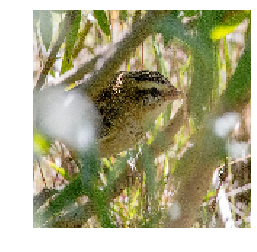

non-bird
schilfrohrsänger_49.jpg


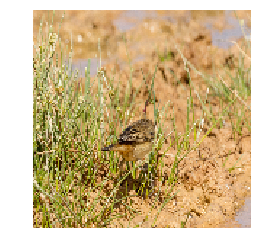

non-bird
schilfrohrsänger_32.jpg


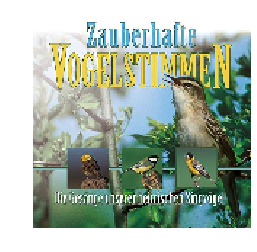

non-bird
schilfrohrsänger_3.jpg


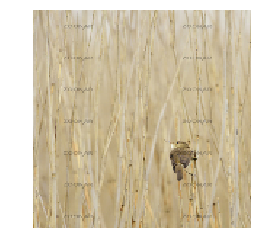

non-bird
schilfrohrsänger_45.jpg


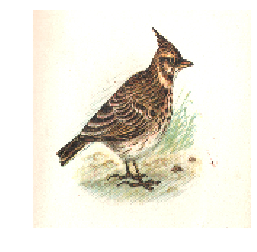

non-bird
haubenlerche_73.jpg


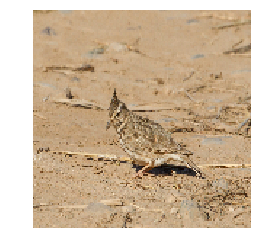

non-bird
haubenlerche_14.jpg


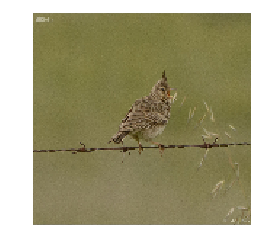

non-bird
haubenlerche_50.jpg


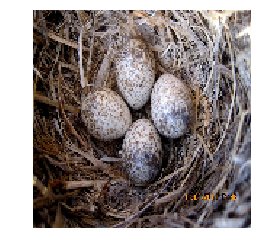

non-bird
haubenlerche_43.jpg


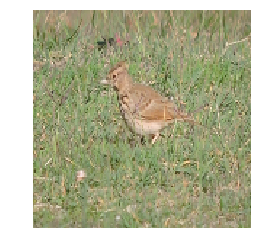

non-bird
haubenlerche_51.jpg


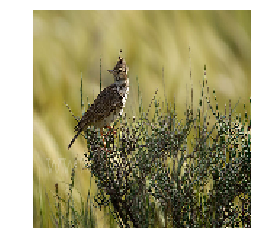

non-bird
haubenlerche_18.jpg


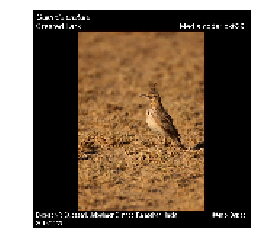

non-bird
haubenlerche_19.jpg


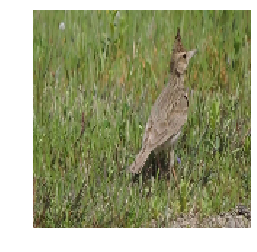

non-bird
haubenlerche_34.jpg


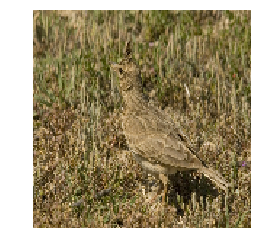

non-bird
haubenlerche_9.jpg


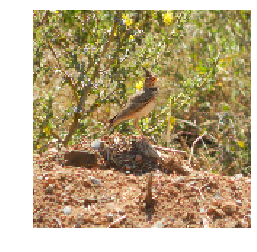

non-bird
haubenlerche_87.jpg


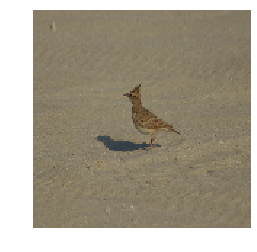

non-bird
haubenlerche_25.jpg


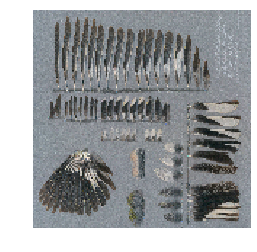

non-bird
buchfink_67.jpg


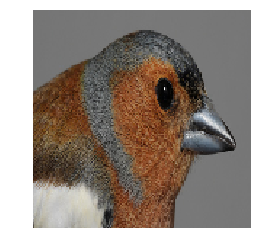

non-bird
buchfink_10.jpg


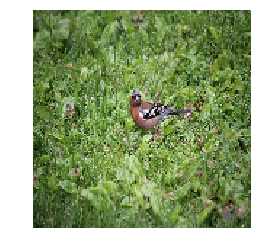

non-bird
buchfink_37.jpg


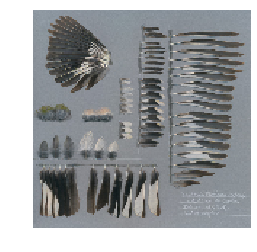

non-bird
buchfink_17.jpg


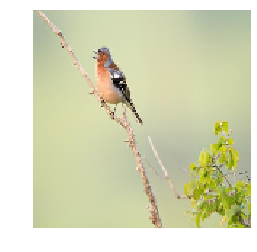

non-bird
buchfink_2.jpg


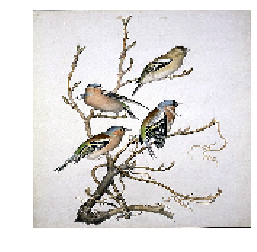

non-bird
buchfink_89.jpg


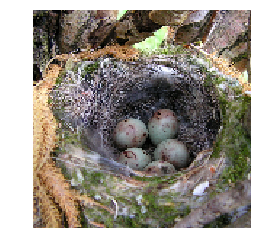

non-bird
buchfink_46.jpg


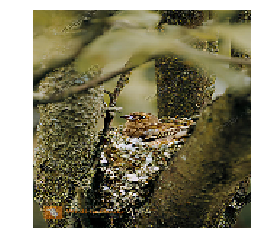

non-bird
buchfink_74.jpg


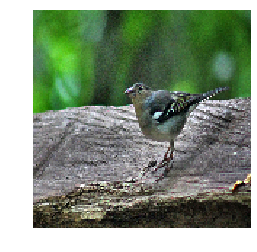

non-bird
buchfink_48.jpg


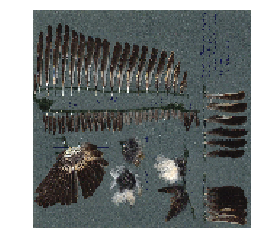

non-bird
trauerschnäpper_27.jpg


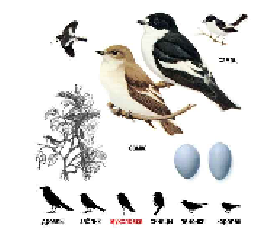

non-bird
trauerschnäpper_92.jpg


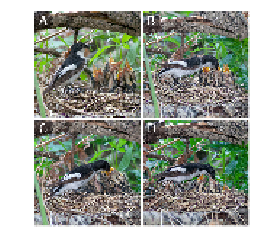

non-bird
trauerschnäpper_12.jpg


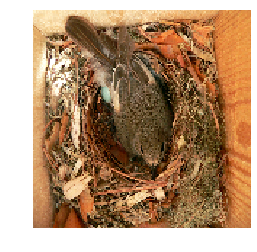

non-bird
trauerschnäpper_44.jpg


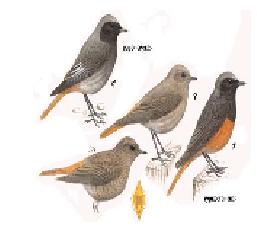

non-bird
hausrotschwanz_86.jpg


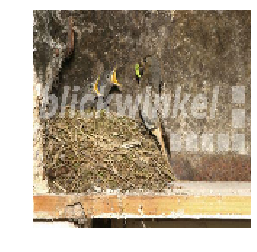

non-bird
hausrotschwanz_23.jpg


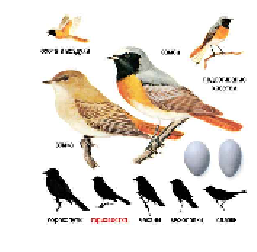

non-bird
hausrotschwanz_93.jpg


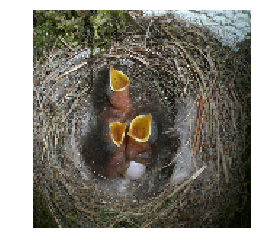

non-bird
hausrotschwanz_27.jpg


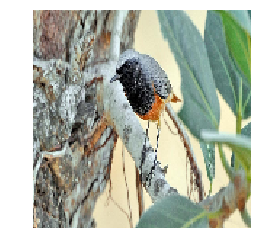

non-bird
hausrotschwanz_6.jpg


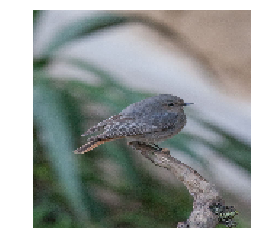

non-bird
hausrotschwanz_26.jpg


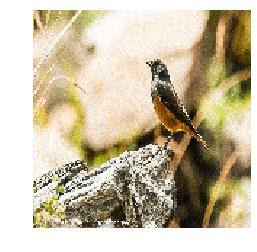

non-bird
hausrotschwanz_88.jpg


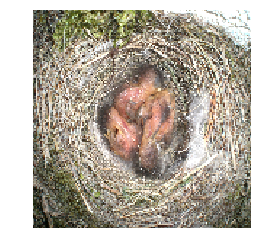

non-bird
hausrotschwanz_13.jpg


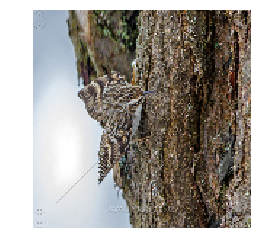

non-bird
gartenbaumläufer_23.jpg


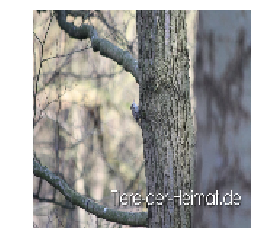

non-bird
gartenbaumläufer_89.jpg


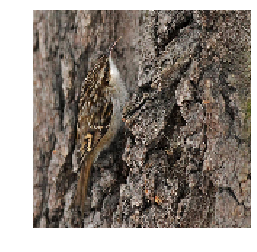

non-bird
gartenbaumläufer_79.jpg


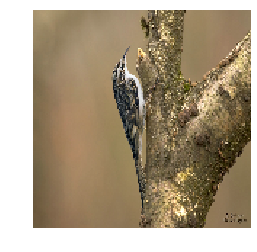

non-bird
gartenbaumläufer_4.jpg


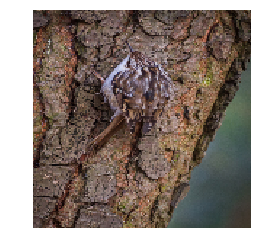

non-bird
gartenbaumläufer_59.jpg


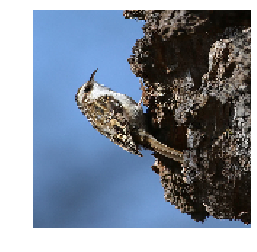

non-bird
gartenbaumläufer_15.jpg


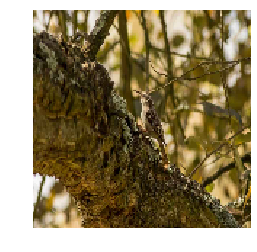

non-bird
gartenbaumläufer_52.jpg


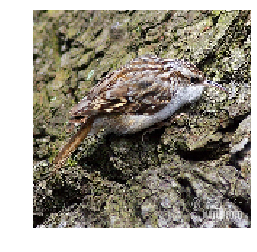

non-bird
gartenbaumläufer_64.jpg


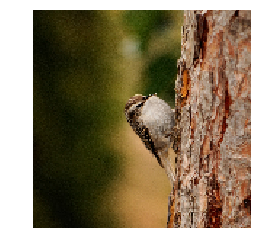

non-bird
gartenbaumläufer_75.jpg


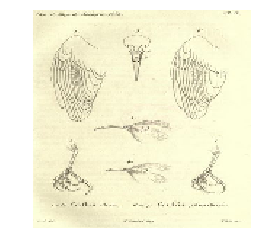

non-bird
gartenbaumläufer_74.jpg


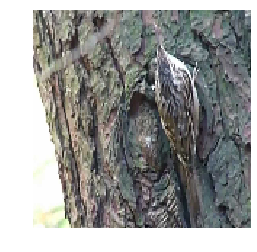

non-bird
gartenbaumläufer_81.jpg


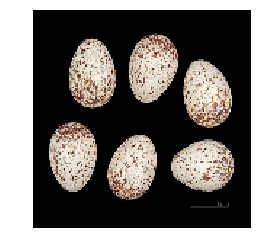

non-bird
gartenbaumläufer_46.jpg


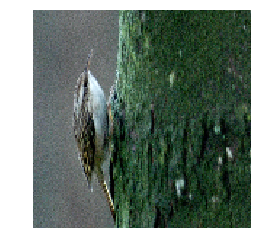

non-bird
gartenbaumläufer_8.jpg


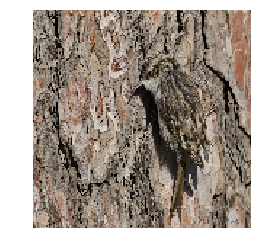

non-bird
gartenbaumläufer_35.jpg


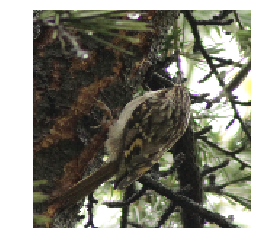

non-bird
gartenbaumläufer_1.jpg


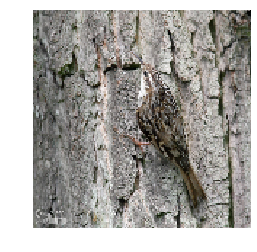

non-bird
gartenbaumläufer_57.jpg


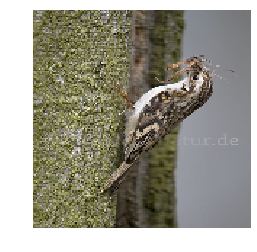

non-bird
gartenbaumläufer_40.jpg


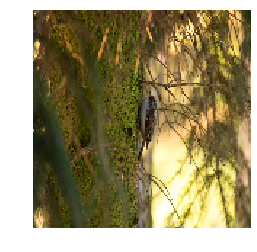

non-bird
gartenbaumläufer_13.jpg


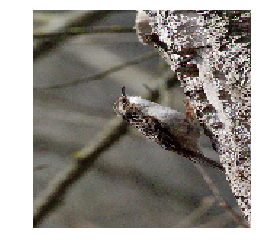

non-bird
gartenbaumläufer_28.jpg


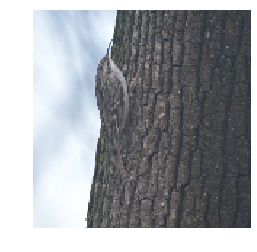

non-bird
gartenbaumläufer_37.jpg


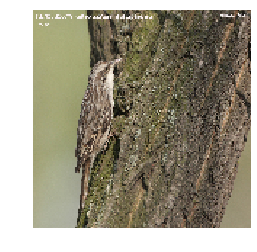

non-bird
gartenbaumläufer_92.jpg


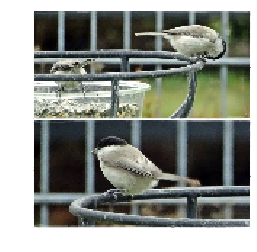

non-bird
sumpfmeise_67.jpg


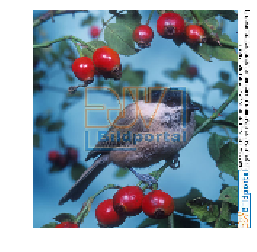

non-bird
sumpfmeise_46.jpg


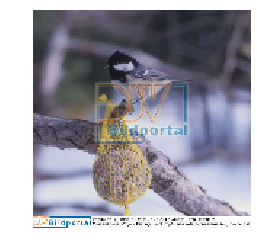

non-bird
sumpfmeise_37.jpg


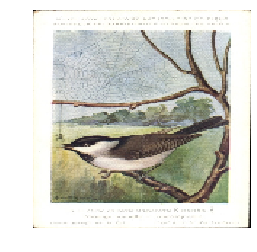

non-bird
sumpfmeise_8.jpg


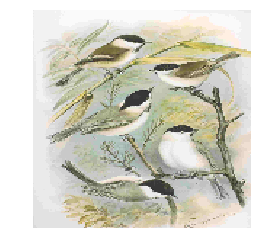

non-bird
sumpfmeise_74.jpg


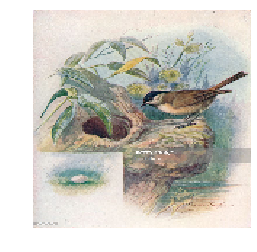

non-bird
sumpfmeise_28.jpg


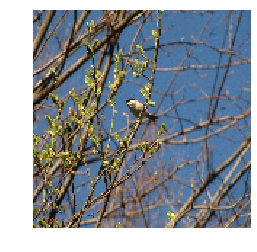

non-bird
sumpfmeise_22.jpg


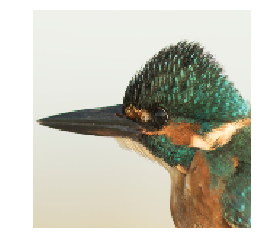

non-bird
eisvogel_0.jpg


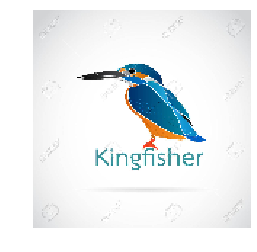

non-bird
eisvogel_15.jpg


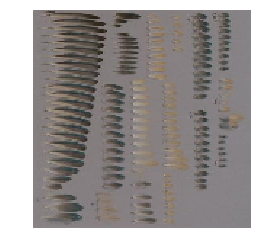

non-bird
eisvogel_16.jpg


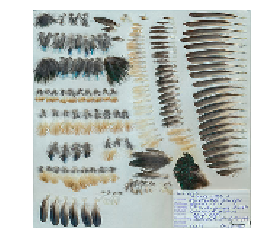

non-bird
eisvogel_74.jpg


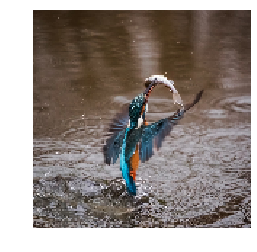

non-bird
eisvogel_32.jpg


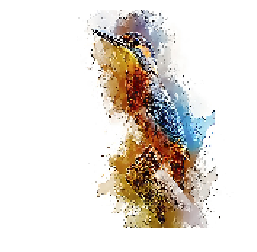

non-bird
eisvogel_6.jpg


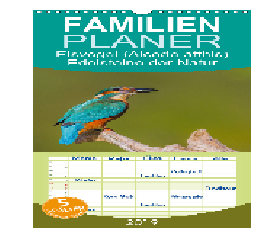

non-bird
eisvogel_9.jpg


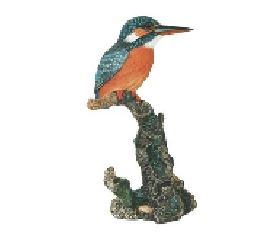

non-bird
eisvogel_51.jpg


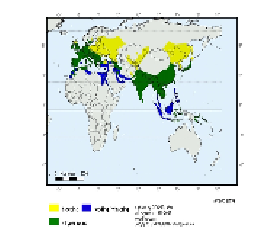

non-bird
eisvogel_92.jpg


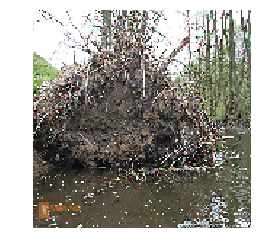

non-bird
eisvogel_20.jpg


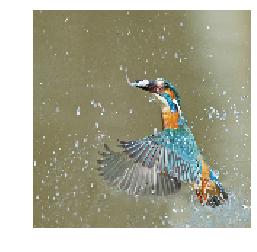

non-bird
eisvogel_26.jpg


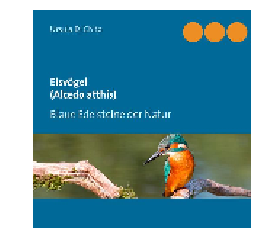

non-bird
eisvogel_46.jpg


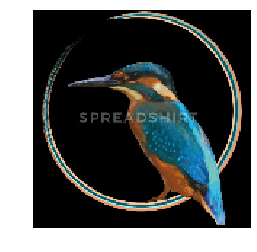

non-bird
eisvogel_54.jpg


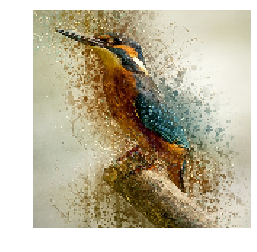

non-bird
eisvogel_14.jpg


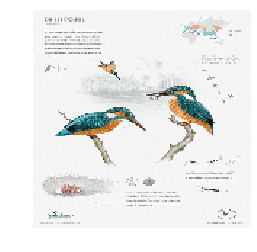

non-bird
eisvogel_2.jpg


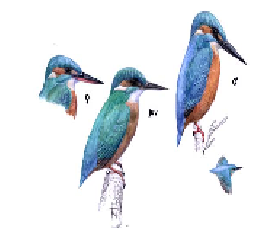

non-bird
eisvogel_73.jpg


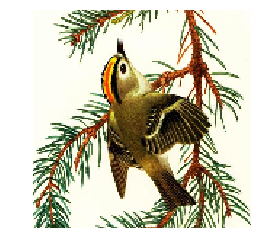

non-bird
wintergoldhähnchen_81.jpg


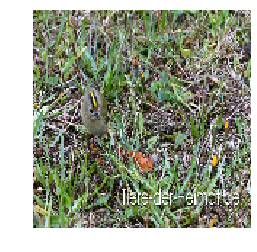

non-bird
wintergoldhähnchen_78.jpg


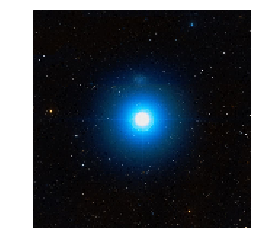

non-bird
wintergoldhähnchen_33.jpg


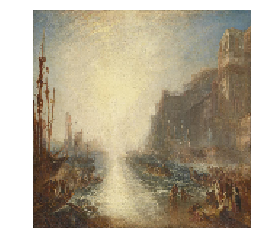

non-bird
wintergoldhähnchen_83.jpg


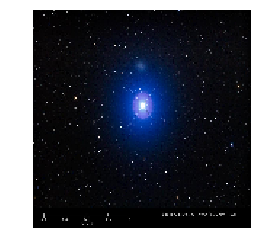

non-bird
wintergoldhähnchen_52.jpg


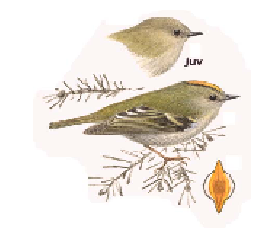

non-bird
wintergoldhähnchen_10.jpg


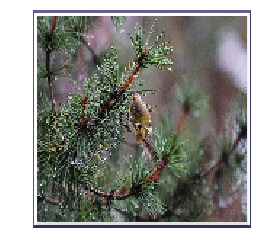

non-bird
wintergoldhähnchen_87.jpg


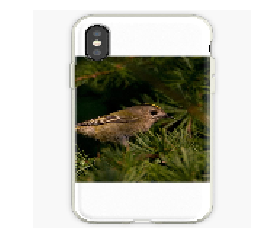

non-bird
wintergoldhähnchen_29.jpg


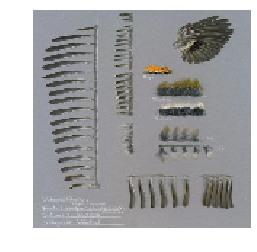

non-bird
wintergoldhähnchen_66.jpg


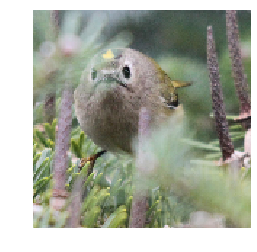

non-bird
wintergoldhähnchen_7.jpg


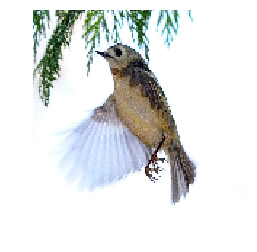

non-bird
wintergoldhähnchen_6.jpg


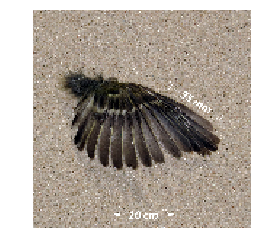

non-bird
wintergoldhähnchen_57.jpg


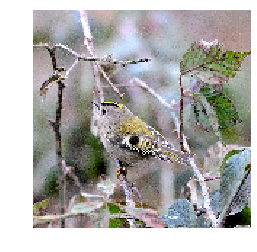

non-bird
wintergoldhähnchen_42.jpg


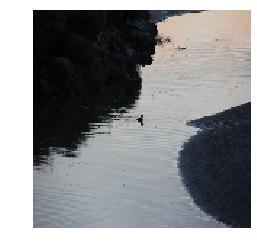

non-bird
zwergtaucher_9.jpg


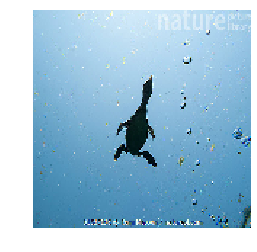

non-bird
zwergtaucher_4.jpg


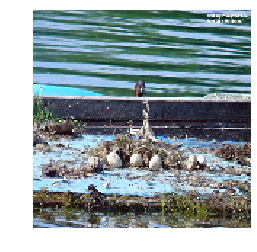

non-bird
zwergtaucher_25.jpg


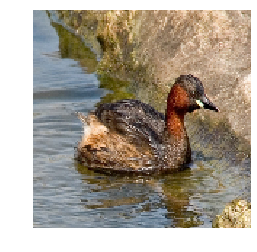

non-bird
zwergtaucher_70.jpg


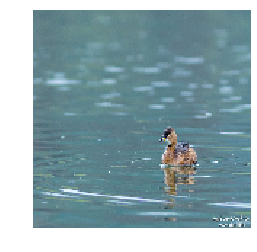

non-bird
zwergtaucher_6.jpg


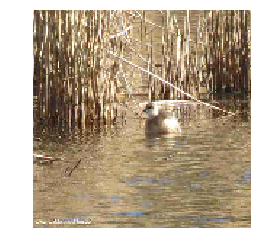

non-bird
zwergtaucher_89.jpg


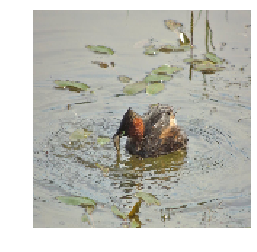

non-bird
zwergtaucher_24.jpg


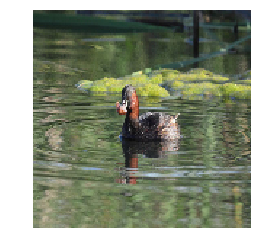

non-bird
zwergtaucher_38.jpg


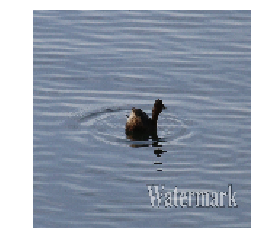

non-bird
zwergtaucher_1.jpg


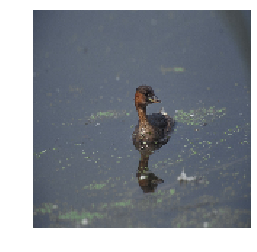

non-bird
zwergtaucher_10.jpg


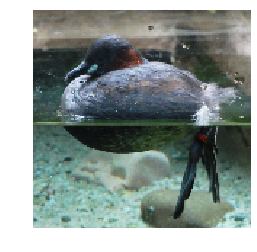

non-bird
zwergtaucher_43.jpg


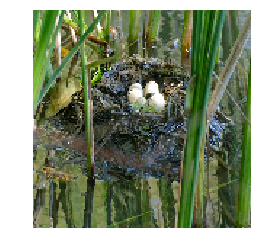

non-bird
zwergtaucher_54.jpg


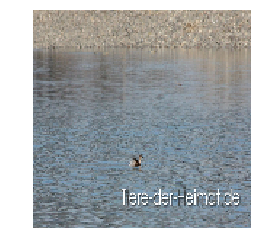

non-bird
zwergtaucher_53.jpg


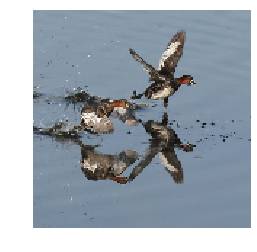

non-bird
zwergtaucher_50.jpg


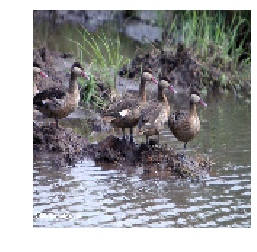

non-bird
zwergtaucher_45.jpg


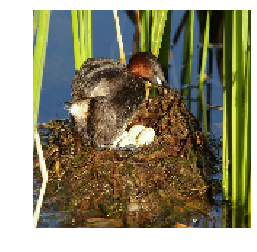

non-bird
zwergtaucher_56.jpg


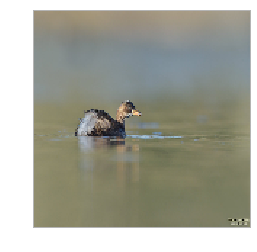

non-bird
zwergtaucher_47.jpg


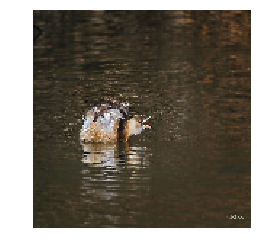

non-bird
zwergtaucher_15.jpg


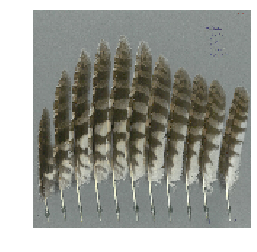

non-bird
waldkauz_43.jpg


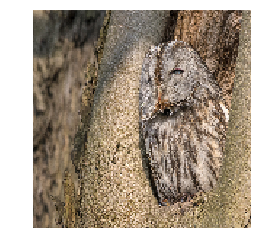

non-bird
waldkauz_24.jpg


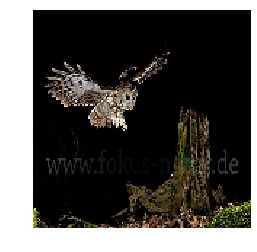

non-bird
waldkauz_2.jpg


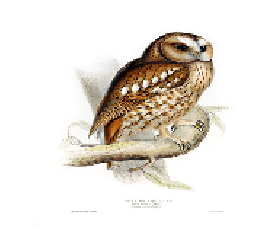

non-bird
waldkauz_74.jpg


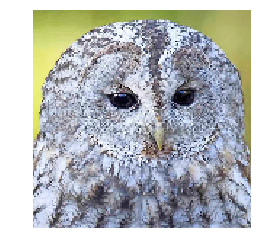

non-bird
waldkauz_44.jpg


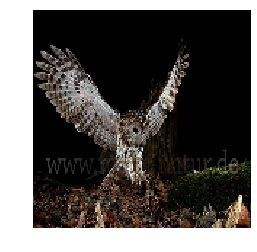

non-bird
waldkauz_61.jpg


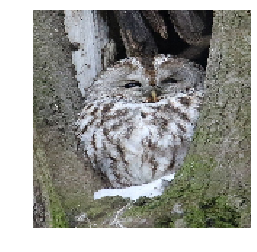

non-bird
waldkauz_78.jpg


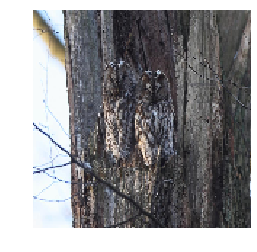

non-bird
waldkauz_17.jpg


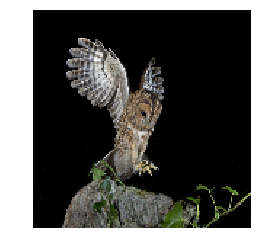

non-bird
waldkauz_14.jpg


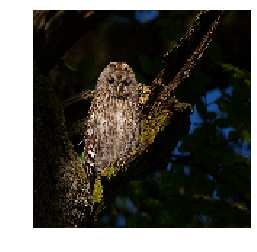

non-bird
waldkauz_8.jpg


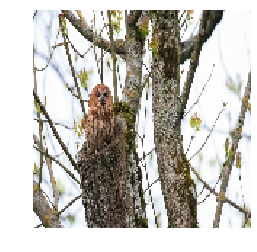

non-bird
waldkauz_45.jpg


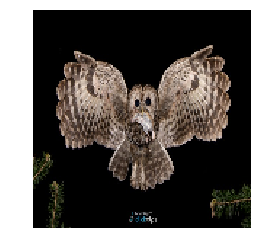

non-bird
waldkauz_12.jpg


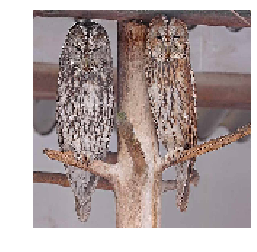

non-bird
waldkauz_68.jpg


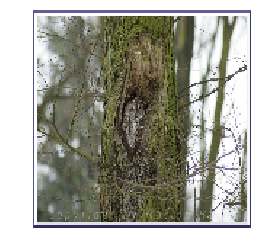

non-bird
waldkauz_77.jpg


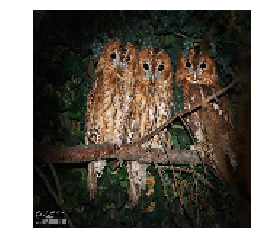

non-bird
waldkauz_46.jpg


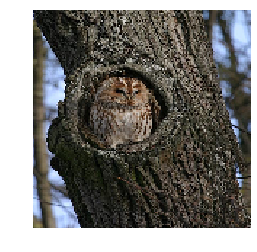

non-bird
waldkauz_36.jpg


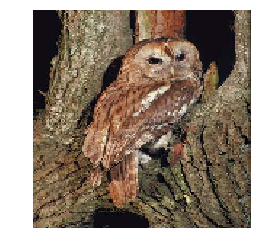

non-bird
waldkauz_0.jpg


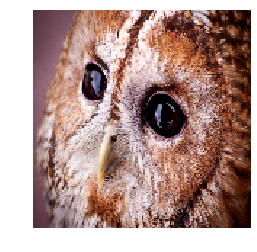

non-bird
waldkauz_50.jpg


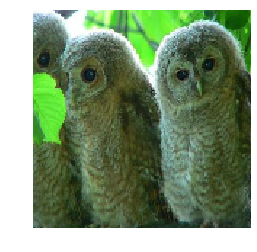

non-bird
waldkauz_84.jpg


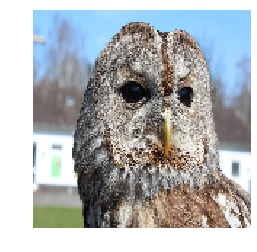

non-bird
waldkauz_83.jpg


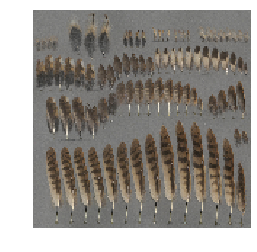

non-bird
waldkauz_3.jpg


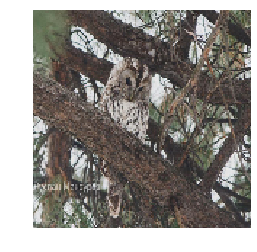

non-bird
waldkauz_11.jpg


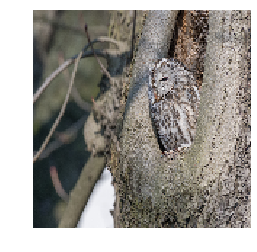

non-bird
waldkauz_30.jpg


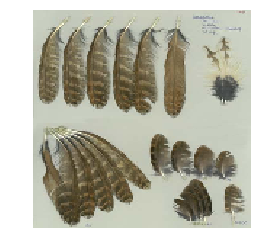

non-bird
waldkauz_42.jpg


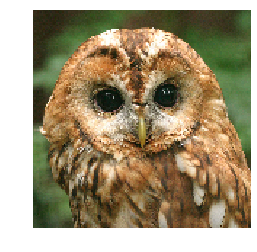

non-bird
waldkauz_69.jpg


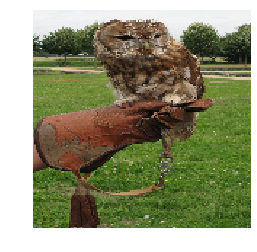

non-bird
waldkauz_47.jpg


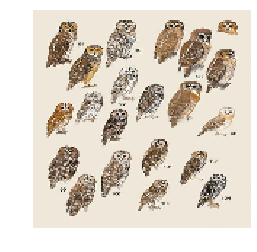

non-bird
waldkauz_38.jpg


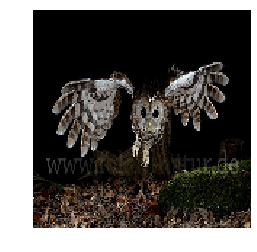

non-bird
waldkauz_73.jpg


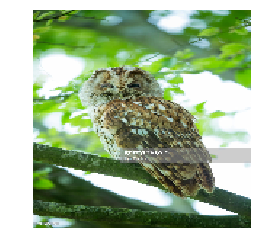

non-bird
waldkauz_80.jpg


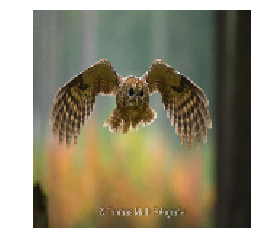

non-bird
waldkauz_5.jpg


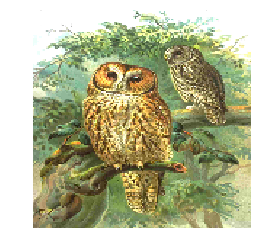

non-bird
waldkauz_7.jpg


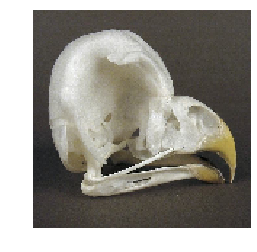

non-bird
waldkauz_57.jpg


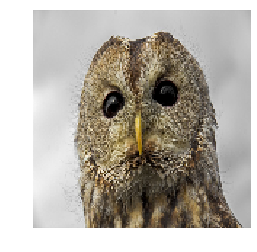

non-bird
waldkauz_52.jpg


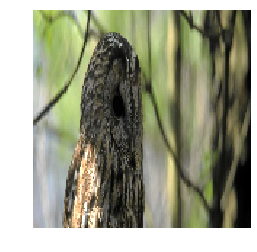

non-bird
waldkauz_21.jpg


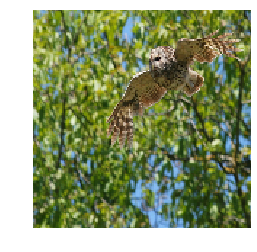

non-bird
waldkauz_28.jpg


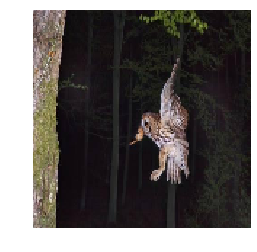

non-bird
waldkauz_22.jpg


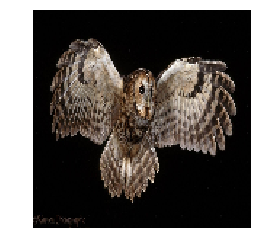

non-bird
waldkauz_34.jpg


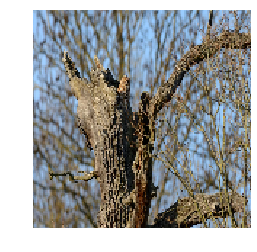

non-bird
waldkauz_16.jpg


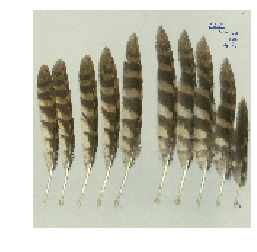

non-bird
waldkauz_64.jpg


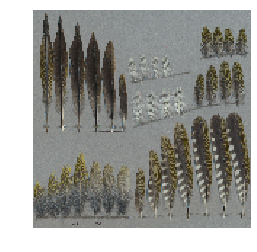

non-bird
grauspecht_64.jpg


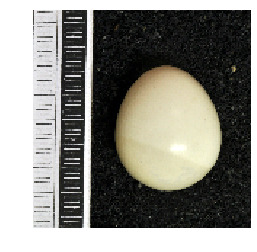

non-bird
grauspecht_38.jpg


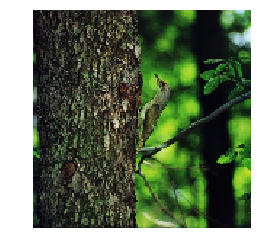

non-bird
grauspecht_2.jpg


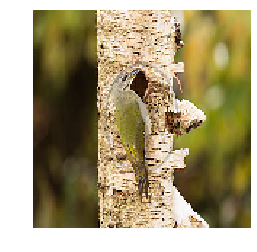

non-bird
grauspecht_16.jpg


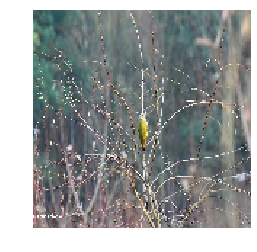

non-bird
grauspecht_8.jpg


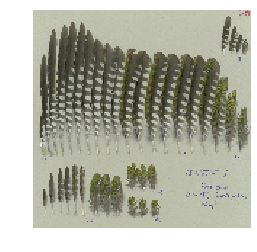

non-bird
grauspecht_73.jpg


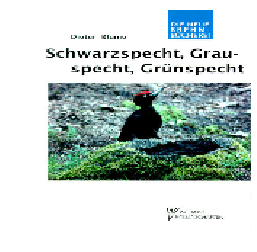

non-bird
grauspecht_32.jpg


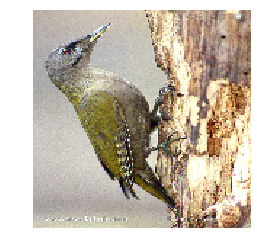

non-bird
grauspecht_89.jpg


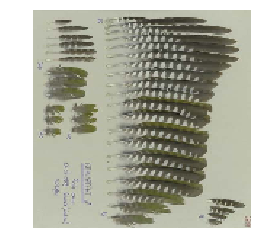

non-bird
grauspecht_48.jpg


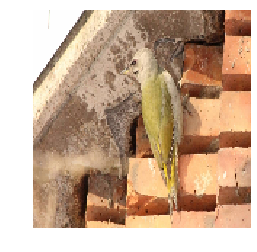

non-bird
grauspecht_42.jpg


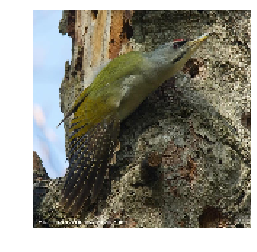

non-bird
grauspecht_25.jpg


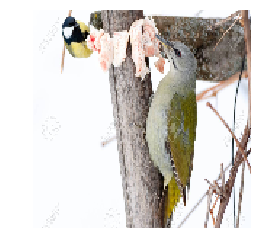

non-bird
grauspecht_83.jpg


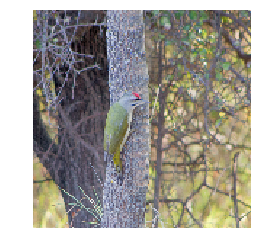

non-bird
grauspecht_65.jpg


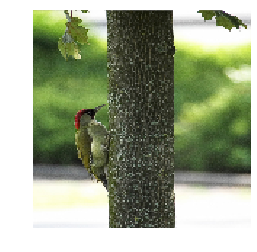

non-bird
grauspecht_10.jpg


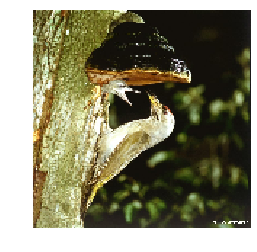

non-bird
grauspecht_71.jpg


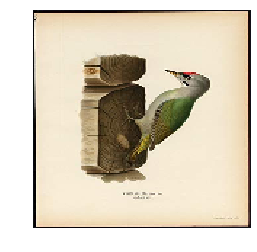

non-bird
grauspecht_66.jpg


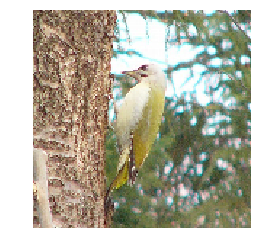

non-bird
grauspecht_75.jpg


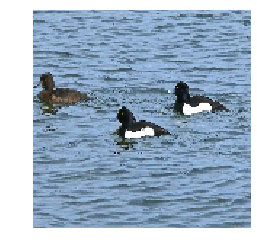

non-bird
reiherente_6.jpg


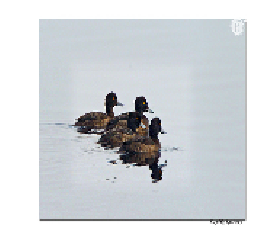

non-bird
reiherente_89.jpg


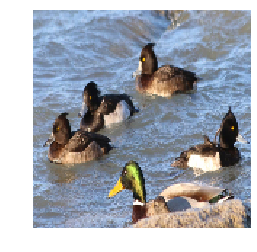

non-bird
reiherente_5.jpg


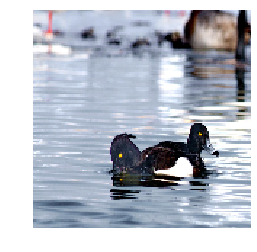

non-bird
reiherente_23.jpg


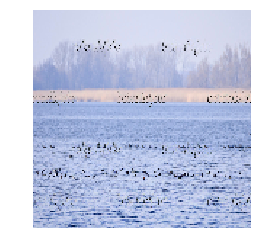

non-bird
reiherente_53.jpg


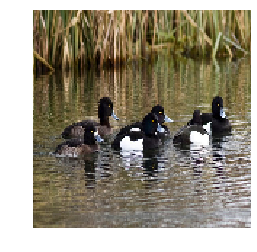

non-bird
reiherente_28.jpg


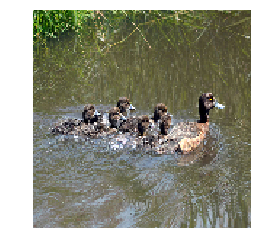

non-bird
reiherente_15.jpg


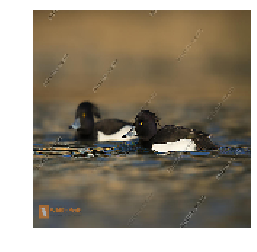

non-bird
reiherente_71.jpg


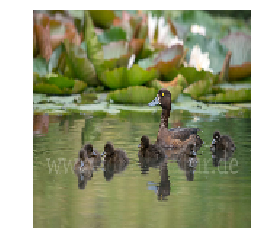

non-bird
reiherente_44.jpg


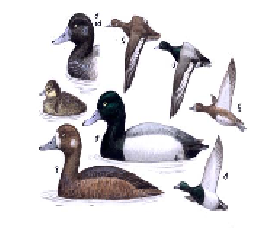

non-bird
reiherente_52.jpg


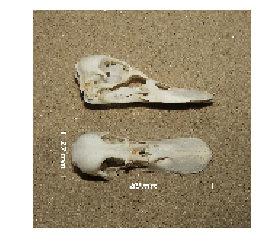

non-bird
reiherente_76.jpg


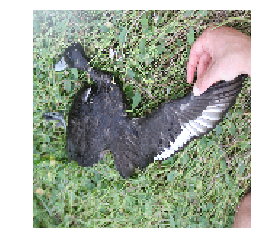

non-bird
reiherente_25.jpg


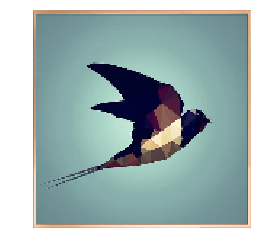

non-bird
rauchschwalbe_6.jpg


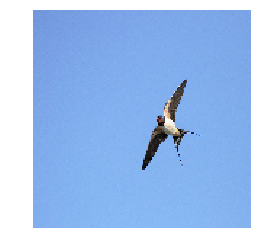

non-bird
rauchschwalbe_61.jpg


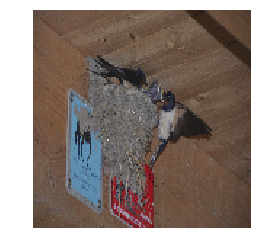

non-bird
rauchschwalbe_22.jpg


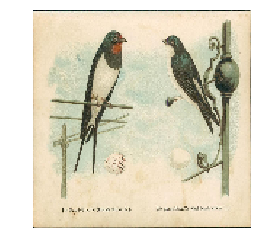

non-bird
rauchschwalbe_60.jpg


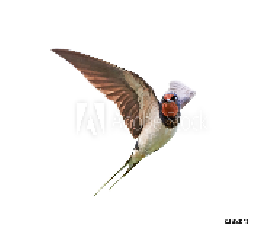

non-bird
rauchschwalbe_65.jpg


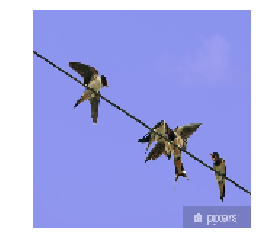

non-bird
rauchschwalbe_87.jpg


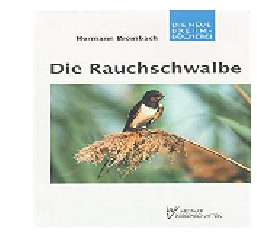

non-bird
rauchschwalbe_85.jpg


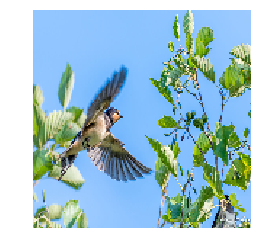

non-bird
rauchschwalbe_67.jpg


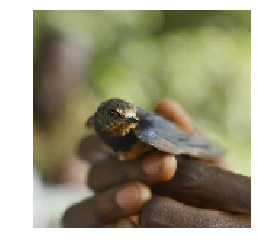

non-bird
rauchschwalbe_19.jpg


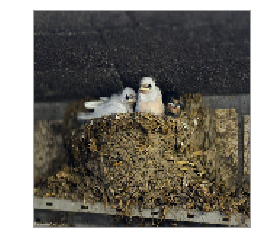

non-bird
rauchschwalbe_25.jpg


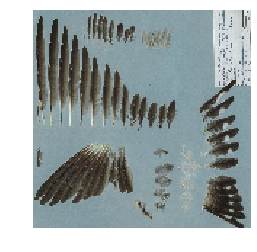

non-bird
rauchschwalbe_72.jpg


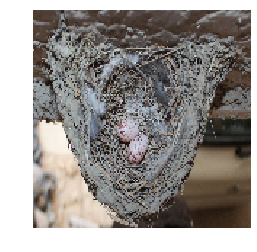

non-bird
rauchschwalbe_5.jpg


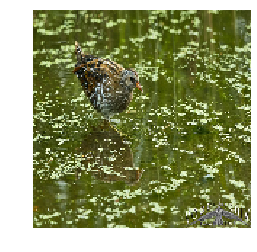

non-bird
tüpfelsumpfhuhn_21.jpg


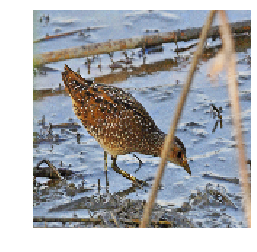

non-bird
tüpfelsumpfhuhn_47.jpg


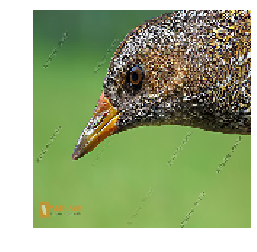

non-bird
tüpfelsumpfhuhn_0.jpg


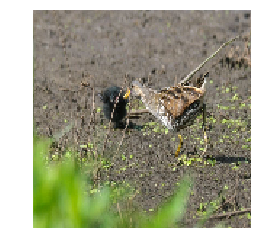

non-bird
tüpfelsumpfhuhn_73.jpg


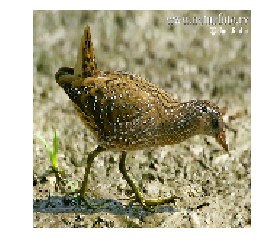

non-bird
tüpfelsumpfhuhn_78.jpg


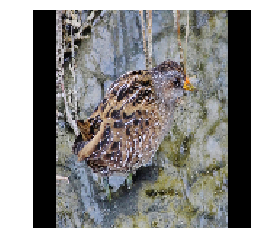

non-bird
tüpfelsumpfhuhn_12.jpg


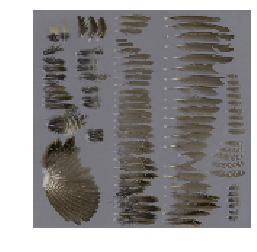

non-bird
tüpfelsumpfhuhn_7.jpg


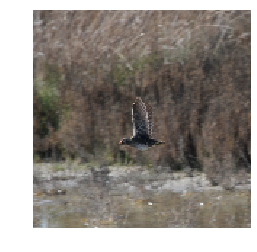

non-bird
tüpfelsumpfhuhn_86.jpg


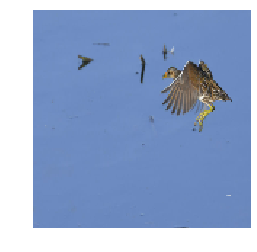

non-bird
tüpfelsumpfhuhn_64.jpg


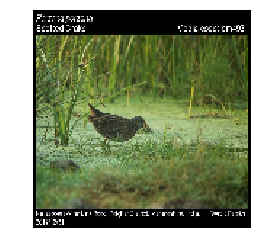

non-bird
tüpfelsumpfhuhn_43.jpg


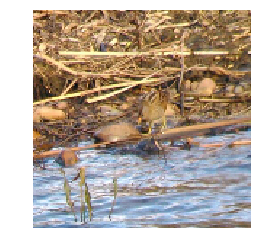

non-bird
tüpfelsumpfhuhn_83.jpg


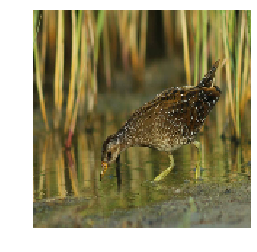

non-bird
tüpfelsumpfhuhn_48.jpg


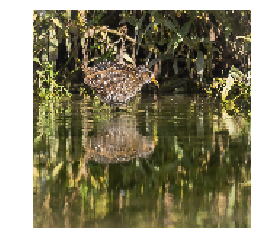

non-bird
tüpfelsumpfhuhn_27.jpg


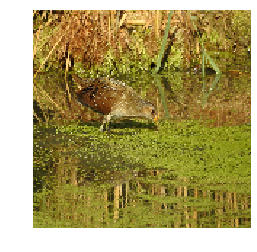

non-bird
tüpfelsumpfhuhn_82.jpg


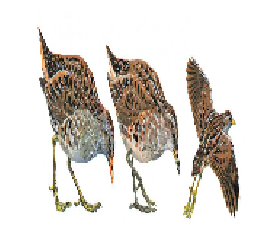

non-bird
tüpfelsumpfhuhn_35.jpg


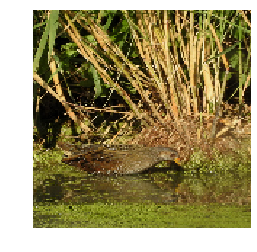

non-bird
tüpfelsumpfhuhn_38.jpg


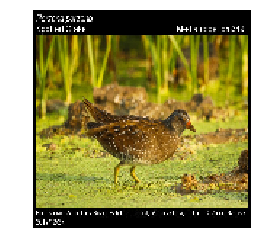

non-bird
tüpfelsumpfhuhn_32.jpg


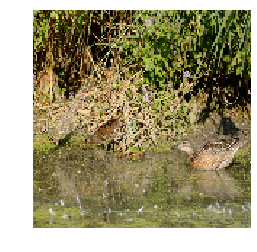

non-bird
tüpfelsumpfhuhn_46.jpg


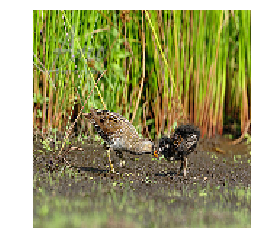

non-bird
tüpfelsumpfhuhn_33.jpg


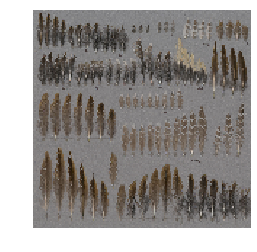

non-bird
tüpfelsumpfhuhn_93.jpg


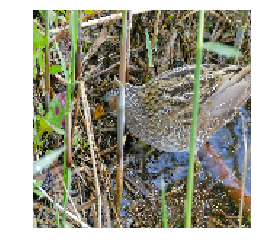

non-bird
tüpfelsumpfhuhn_71.jpg


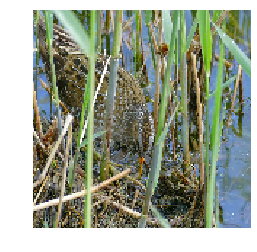

non-bird
tüpfelsumpfhuhn_58.jpg


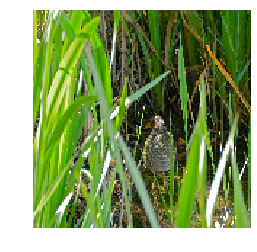

non-bird
tüpfelsumpfhuhn_11.jpg


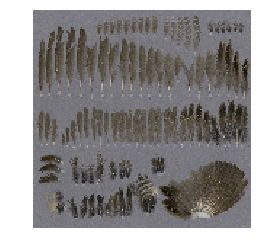

non-bird
tüpfelsumpfhuhn_28.jpg


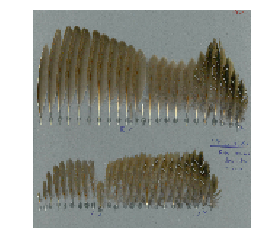

non-bird
tüpfelsumpfhuhn_36.jpg


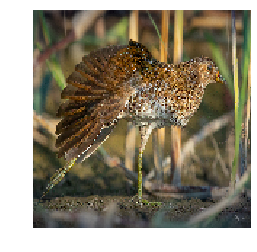

non-bird
tüpfelsumpfhuhn_26.jpg


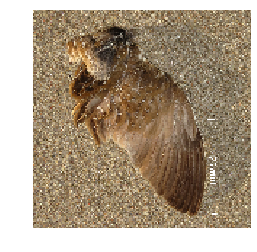

non-bird
tüpfelsumpfhuhn_40.jpg


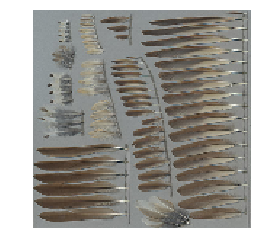

non-bird
singdrossel_86.jpg


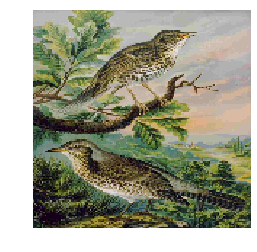

non-bird
singdrossel_72.jpg


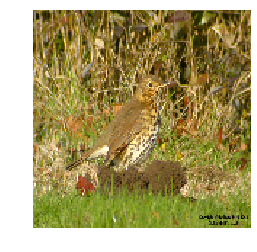

non-bird
singdrossel_53.jpg


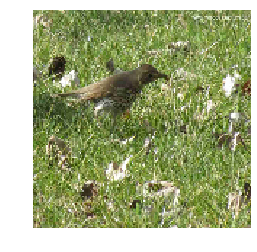

non-bird
singdrossel_39.jpg


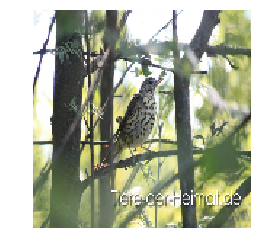

non-bird
singdrossel_51.jpg


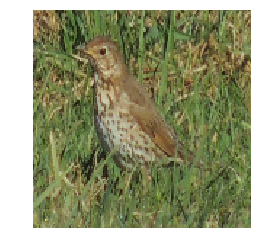

non-bird
singdrossel_63.jpg


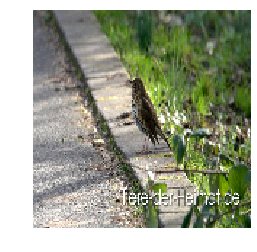

non-bird
singdrossel_41.jpg


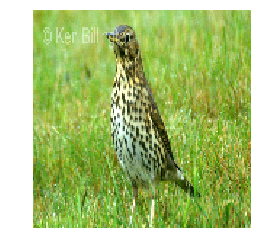

non-bird
singdrossel_40.jpg


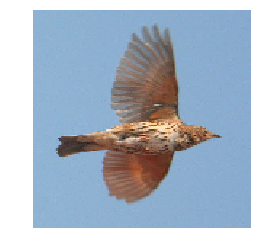

non-bird
singdrossel_59.jpg


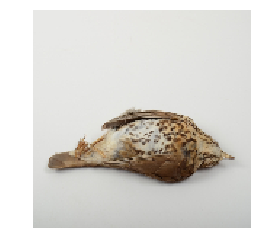

non-bird
singdrossel_34.jpg


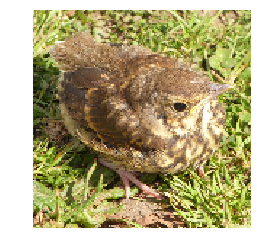

non-bird
singdrossel_25.jpg


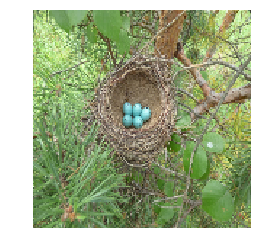

non-bird
singdrossel_22.jpg


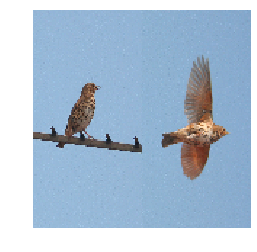

non-bird
singdrossel_1.jpg


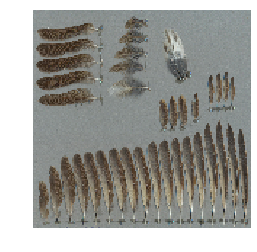

non-bird
singdrossel_12.jpg


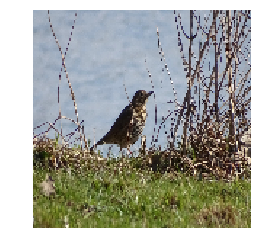

non-bird
singdrossel_62.jpg


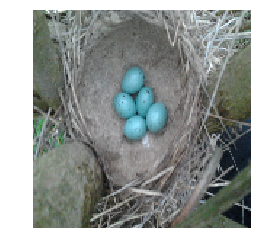

non-bird
singdrossel_80.jpg


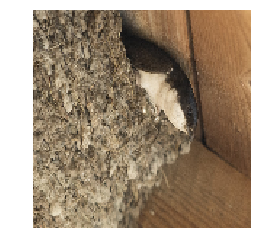

non-bird
mehlschwalbe_65.jpg


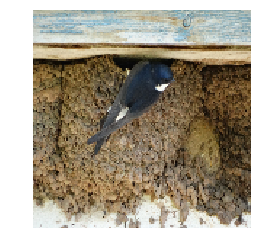

non-bird
mehlschwalbe_18.jpg


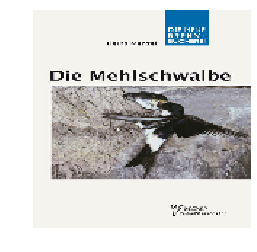

non-bird
mehlschwalbe_70.jpg


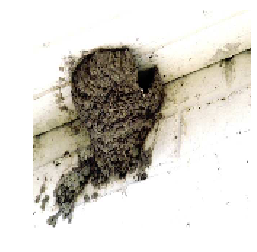

non-bird
mehlschwalbe_15.jpg


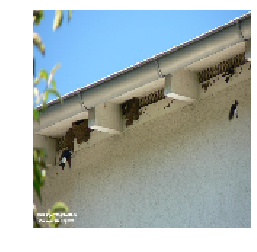

non-bird
mehlschwalbe_48.jpg


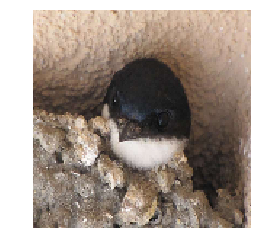

non-bird
mehlschwalbe_26.jpg


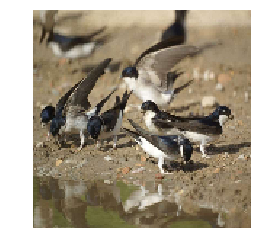

non-bird
mehlschwalbe_41.jpg


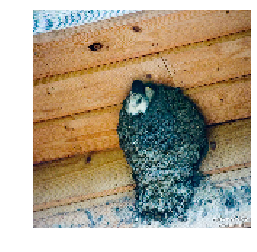

non-bird
mehlschwalbe_75.jpg


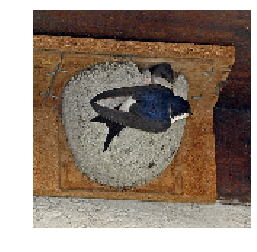

non-bird
mehlschwalbe_44.jpg


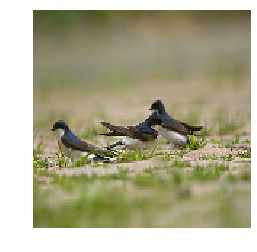

non-bird
mehlschwalbe_38.jpg


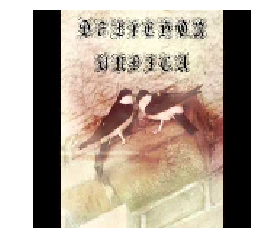

non-bird
mehlschwalbe_58.jpg


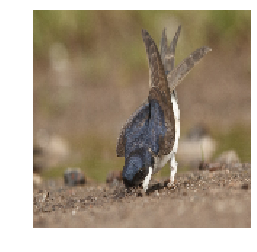

non-bird
mehlschwalbe_6.jpg


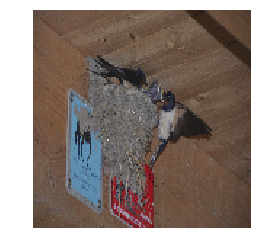

non-bird
mehlschwalbe_10.jpg


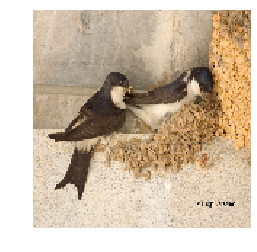

non-bird
mehlschwalbe_23.jpg


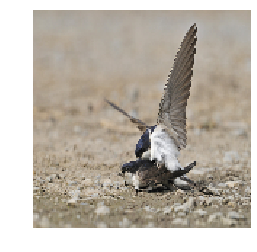

non-bird
mehlschwalbe_79.jpg


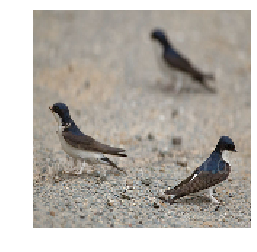

non-bird
mehlschwalbe_36.jpg


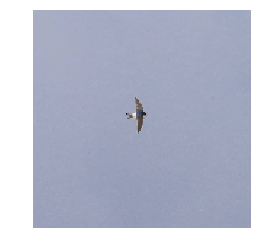

non-bird
mehlschwalbe_4.jpg


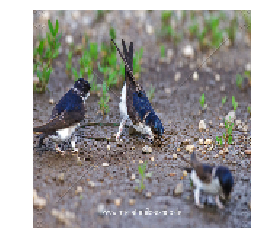

non-bird
mehlschwalbe_66.jpg


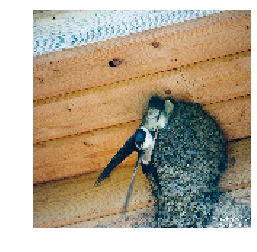

non-bird
mehlschwalbe_91.jpg


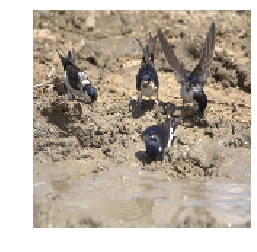

non-bird
mehlschwalbe_56.jpg


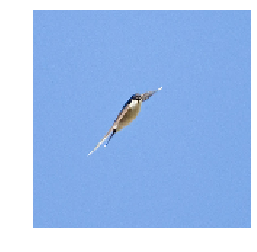

non-bird
mehlschwalbe_14.jpg


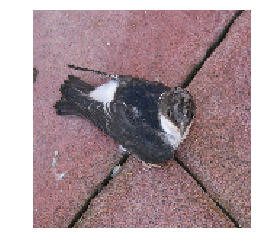

non-bird
mehlschwalbe_12.jpg


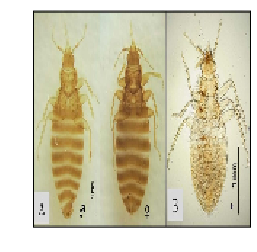

non-bird
mehlschwalbe_74.jpg


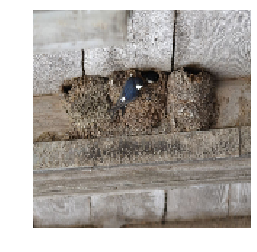

non-bird
mehlschwalbe_21.jpg


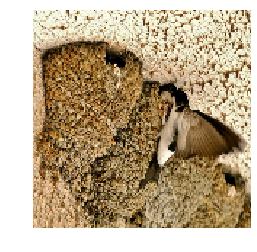

non-bird
mehlschwalbe_30.jpg


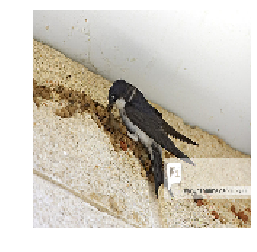

non-bird
mehlschwalbe_25.jpg


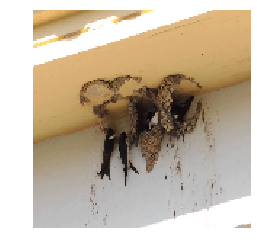

non-bird
mehlschwalbe_68.jpg


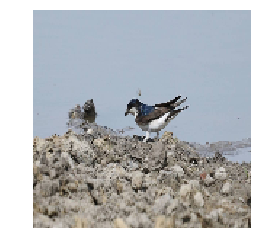

non-bird
mehlschwalbe_46.jpg


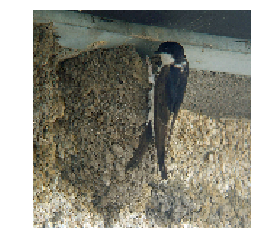

non-bird
mehlschwalbe_83.jpg


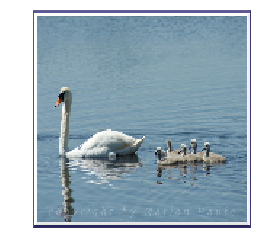

non-bird
höckerschwan_70.jpg


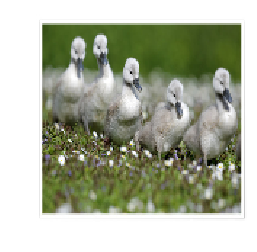

non-bird
höckerschwan_38.jpg


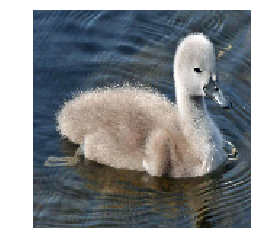

non-bird
höckerschwan_33.jpg


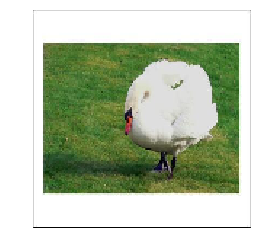

non-bird
höckerschwan_4.jpg


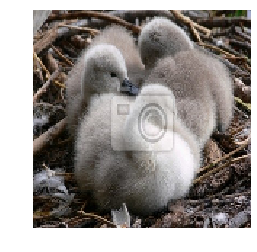

non-bird
höckerschwan_15.jpg


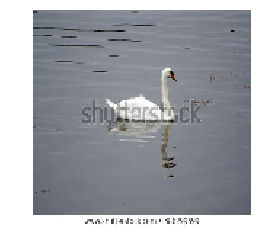

non-bird
höckerschwan_89.jpg


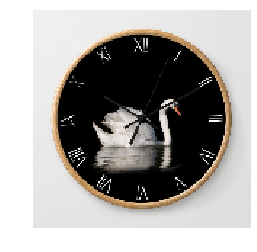

non-bird
höckerschwan_67.jpg


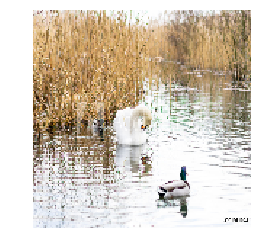

non-bird
höckerschwan_7.jpg


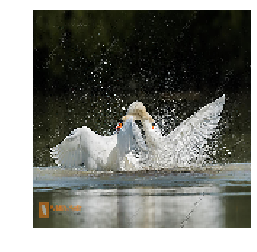

non-bird
höckerschwan_24.jpg


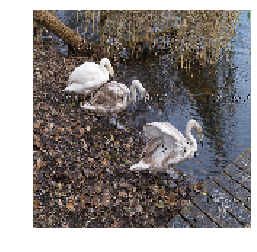

non-bird
höckerschwan_52.jpg


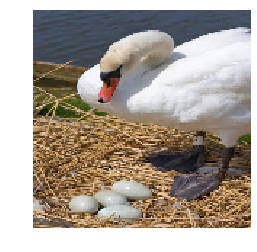

non-bird
höckerschwan_69.jpg


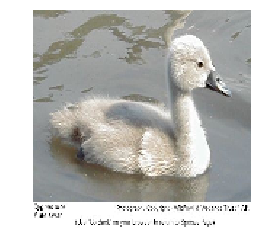

non-bird
höckerschwan_74.jpg


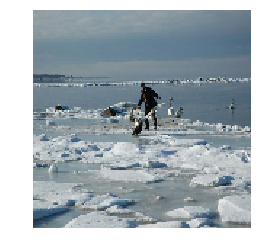

non-bird
höckerschwan_10.jpg


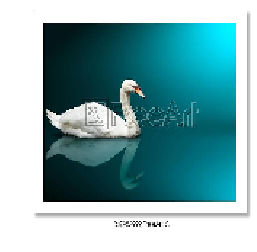

non-bird
höckerschwan_78.jpg


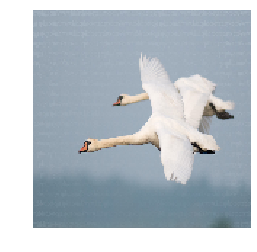

non-bird
höckerschwan_6.jpg


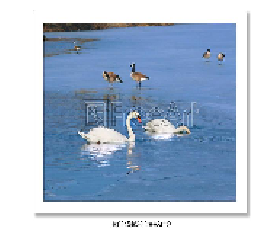

non-bird
höckerschwan_43.jpg


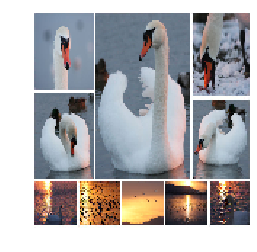

non-bird
höckerschwan_0.jpg


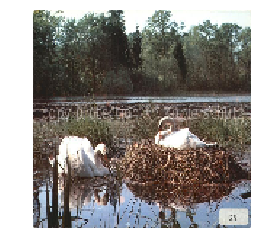

non-bird
höckerschwan_18.jpg


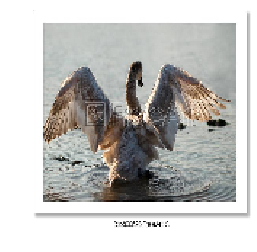

non-bird
höckerschwan_23.jpg


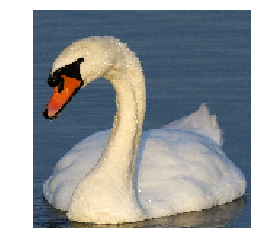

non-bird
höckerschwan_87.jpg


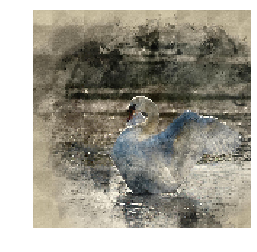

non-bird
höckerschwan_44.jpg


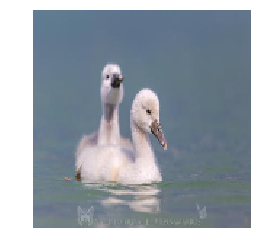

non-bird
höckerschwan_20.jpg


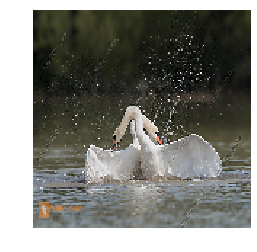

non-bird
höckerschwan_9.jpg


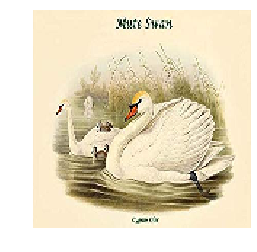

non-bird
höckerschwan_71.jpg


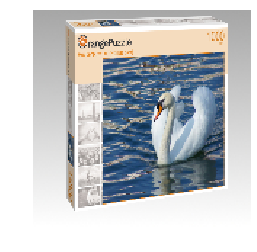

non-bird
höckerschwan_40.jpg


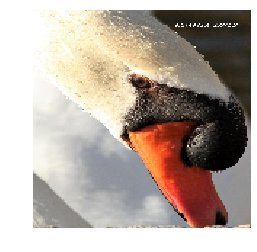

non-bird
höckerschwan_22.jpg


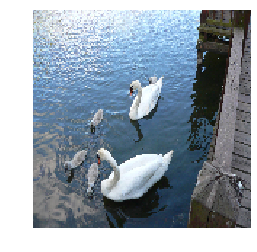

non-bird
höckerschwan_59.jpg


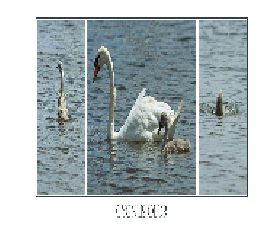

non-bird
höckerschwan_77.jpg


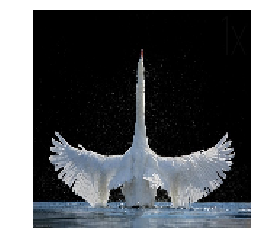

non-bird
höckerschwan_27.jpg


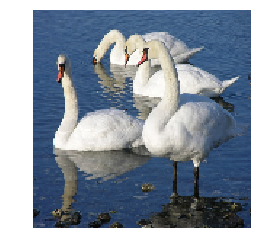

non-bird
höckerschwan_90.jpg


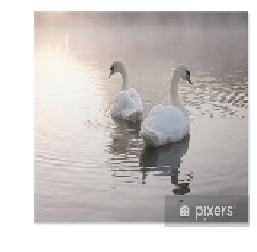

non-bird
höckerschwan_49.jpg


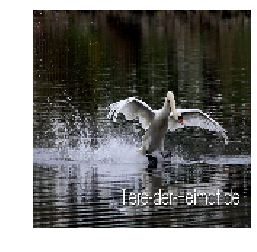

non-bird
höckerschwan_35.jpg


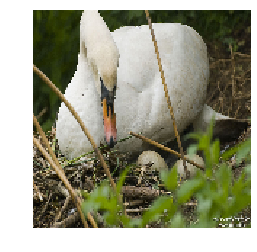

non-bird
höckerschwan_45.jpg


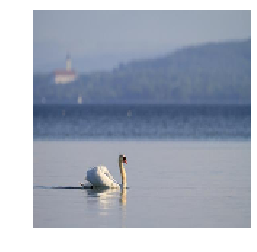

non-bird
höckerschwan_12.jpg


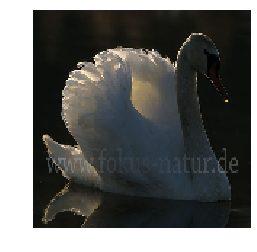

non-bird
höckerschwan_48.jpg


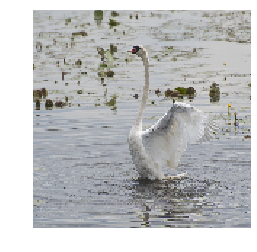

non-bird
höckerschwan_14.jpg


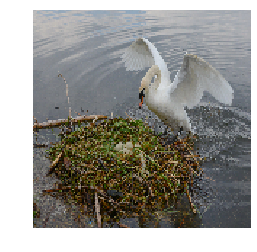

non-bird
höckerschwan_32.jpg


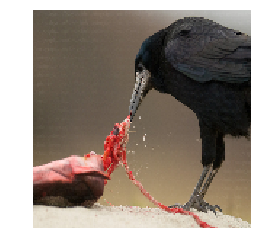

non-bird
saatkrähe_57.jpg


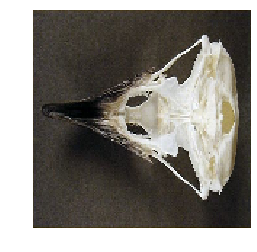

non-bird
saatkrähe_40.jpg


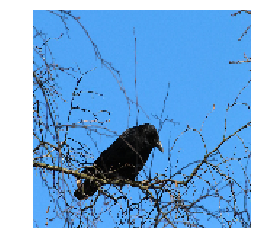

non-bird
saatkrähe_19.jpg


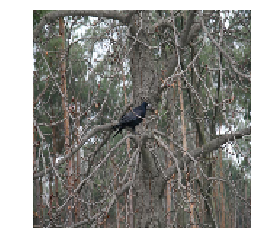

non-bird
saatkrähe_85.jpg


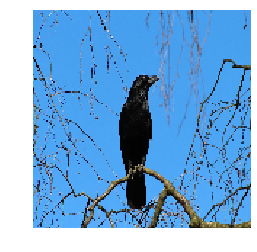

non-bird
saatkrähe_68.jpg


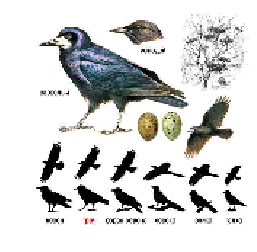

non-bird
saatkrähe_66.jpg


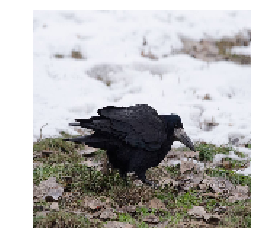

non-bird
saatkrähe_3.jpg


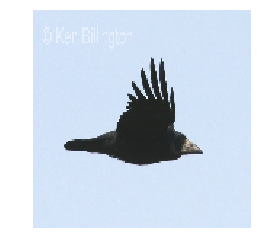

non-bird
saatkrähe_74.jpg


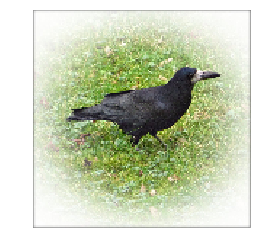

non-bird
saatkrähe_15.jpg


In [0]:
for root,dirs,files in os.walk("drive/My Drive/Colab Notebooks/birds/data"):
  for filename in files:
    img = os.path.join(root,filename)
    new_image = prepare_image(img)
    y_prob = model.predict(new_image)
    y_classes = y_prob.argmax(axis=-1)
    if y_classes[0] == 1:
      load_image(img, True)
      predicted_label = sorted(labels)[y_classes[0]]
      print(predicted_label)
      print (filename)
    
    